# Import Required Libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import math

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

#  Load & Preview Dataset

In [ ]:
# Load dataset
df = pd.read_csv(r"P:\SEM 5 OLD one\startup data.csv")

# Convert 'status' to numeric values (e.g., 'acquired' = 1, 'closed' = 0)
status_mapping = {status: idx for idx, status in enumerate(df['status'].unique())}
df['status_numeric'] = df['status'].map(status_mapping)

# Preview data info
print("Initial Data Info:")
print(df.info())
df.head()


Initial Data Info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 923 entries, 0 to 922
Data columns (total 50 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Unnamed: 0                923 non-null    int64  
 1   state_code                923 non-null    object 
 2   latitude                  923 non-null    float64
 3   longitude                 923 non-null    float64
 4   zip_code                  923 non-null    object 
 5   id                        923 non-null    object 
 6   city                      923 non-null    object 
 7   Unnamed: 6                430 non-null    object 
 8   name                      923 non-null    object 
 9   labels                    923 non-null    int64  
 10  founded_at                923 non-null    object 
 11  closed_at                 335 non-null    object 
 12  first_funding_at          923 non-null    object 
 13  last_funding_at           923 non-null    obje

,Unnamed: 0,state_code,latitude,longitude,zip_code,id,city,Unnamed: 6,name,labels,...,has_VC,has_angel,has_roundA,has_roundB,has_roundC,has_roundD,avg_participants,is_top500,status,status_numeric
0,1005,CA,42.358880,-71.056820,92101,c:6669,San Diego,NaN,Bandsintown,1,...,0,1,0,0,0,0,1.0000,0,acquired,0
1,204,CA,37.238916,-121.973718,95032,c:16283,Los Gatos,NaN,TriCipher,1,...,1,0,0,1,1,1,4.7500,1,acquired,0
2,1001,CA,32.901049,-117.192656,92121,c:65620,San Diego,San Diego CA 92121,Plixi,1,...,0,0,1,0,0,0,4.0000,1,acquired,0
3,738,CA,37.320309,-122.050040,95014,c:42668,Cupertino,Cupertino CA 95014,Solidcore Systems,1,...,0,0,0,1,1,1,3.3333,1,acquired,0
4,1002,CA,37.779281,-122.419236,94105,c:65806,San Francisco,San Francisco CA 94105,Inhale Digital,0,...,1,1,0,0,0,0,1.0000,1,closed,1


# Handle Missing Values

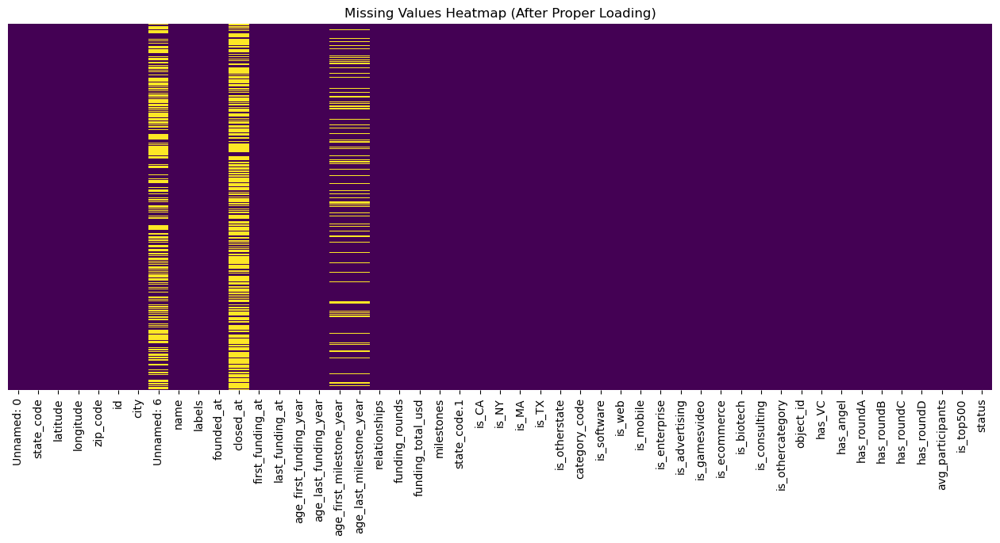

Columns with Missing Values:

closed_at                   588
Unnamed: 6                  493
age_first_milestone_year    152
age_last_milestone_year     152
state_code.1                  1
dtype: int64


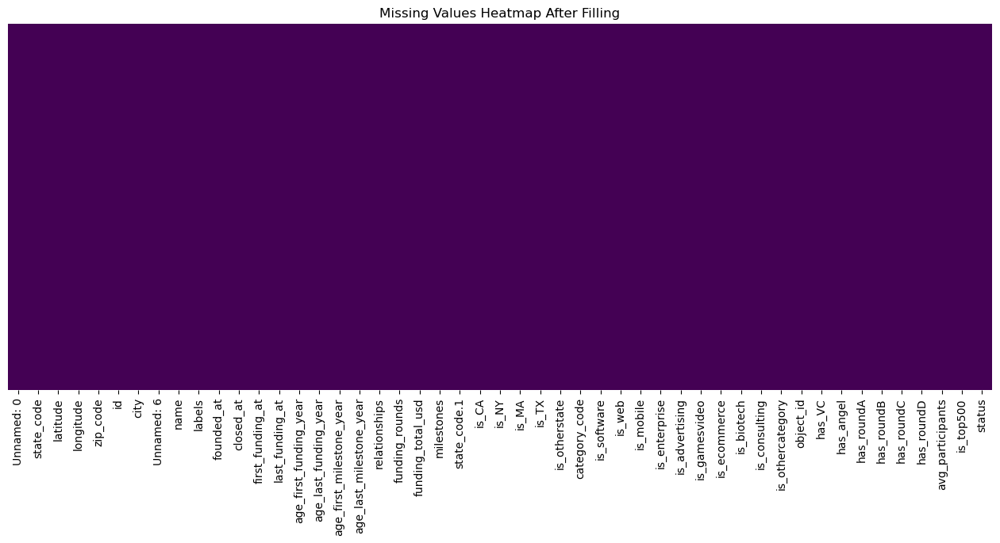

✅ Total missing values remaining: 0


In [ ]:
# Step 1: Load the dataset with custom NA values
na_values = ["NaN", "nan", "NULL", "null", "", "None"]
df = pd.read_csv(r"C:\Users\Locini\Downloads\startup data.csv", na_values=na_values)

# Step 2: Visualize missing values heatmap
plt.figure(figsize=(16, 6))
sns.heatmap(df.isnull(), cbar=False, yticklabels=False, cmap='viridis')
plt.title("Missing Values Heatmap (After Proper Loading)")
plt.show()

# Step 3: Print a summary of missing values
missing_summary = df.isnull().sum()
missing_summary = missing_summary[missing_summary > 0].sort_values(ascending=False)

# Display columns with missing values and their counts
print("Columns with Missing Values:\n")
print(missing_summary)

# Separate numeric and categorical columns
numeric_cols = df.select_dtypes(include=['float64', 'int64']).columns
categorical_cols = df.select_dtypes(include=['object', 'category']).columns

# Fill numeric columns with median
df[numeric_cols] = df[numeric_cols].fillna(df[numeric_cols].median())

# Fill categorical columns with mode
for col in categorical_cols:
    df[col] = df[col].fillna(df[col].mode()[0])

# Step 4: Show heatmap again (after filling)
plt.figure(figsize=(16, 6))
sns.heatmap(df.isnull(), cbar=False, yticklabels=False, cmap='viridis')
plt.title("Missing Values Heatmap After Filling")
plt.show()

# Optional: Confirm no missing values remain
print("✅ Total missing values remaining:", df.isnull().sum().sum())

# Summary Statistics

In [ ]:
print("\nSummary Statistics:")

# Numeric Summary
numeric_summary = df.describe().T
print(numeric_summary)



Summary Statistics:
                          count          mean           std           min  \
Unnamed: 0                923.0  5.722979e+02  3.335854e+02      1.000000   
latitude                  923.0  3.851744e+01  3.741497e+00     25.752358   
longitude                 923.0 -1.035392e+02  2.239417e+01   -122.756956   
labels                    923.0  6.468039e-01  4.782221e-01      0.000000   
age_first_funding_year    923.0  2.235630e+00  2.510449e+00     -9.046600   
age_last_funding_year     923.0  3.931456e+00  2.967910e+00     -9.046600   
age_first_milestone_year  923.0  2.967273e+00  2.727845e+00    -14.169900   
age_last_milestone_year   923.0  4.708687e+00  2.937226e+00     -7.005500   
relationships             923.0  7.710726e+00  7.265776e+00      0.000000   
funding_rounds            923.0  2.310943e+00  1.390922e+00      1.000000   
funding_total_usd         923.0  2.541975e+07  1.896344e+08  11000.000000   
milestones                923.0  1.841820e+00  1.322632

# Correlation Heatmap

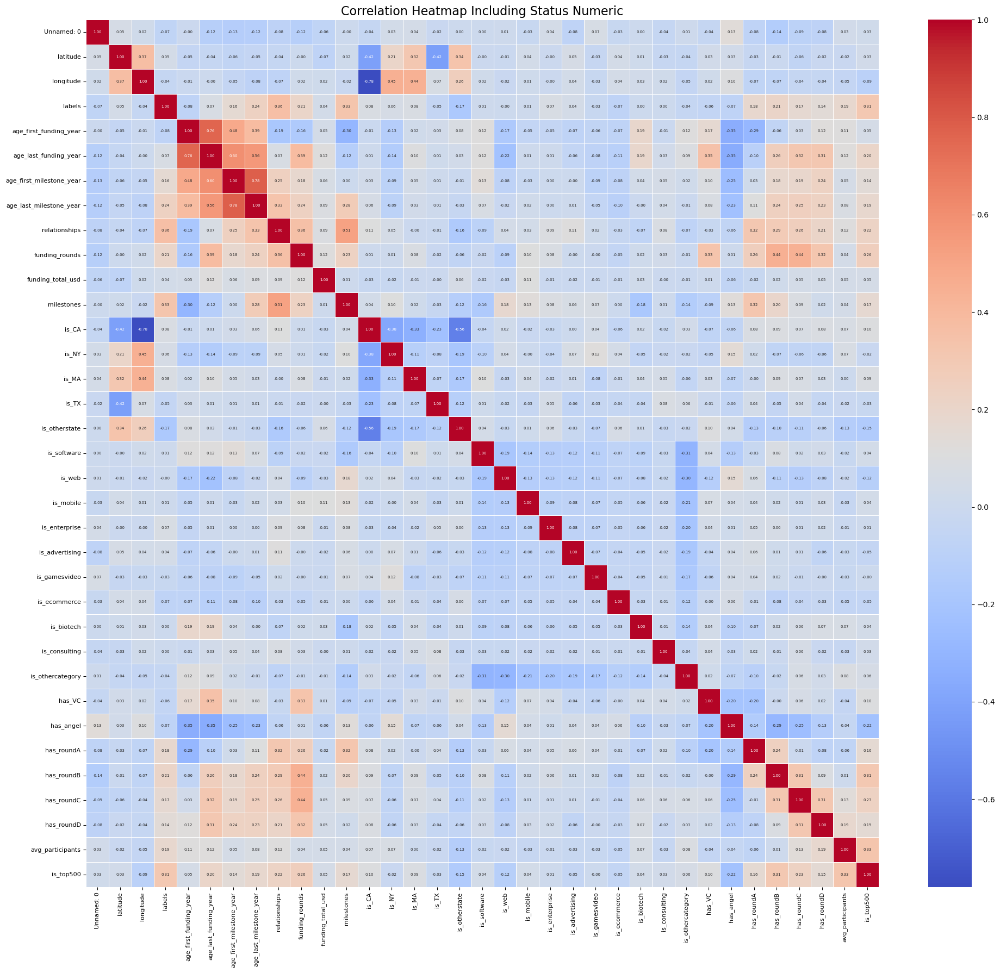

In [ ]:
numeric_df = df.select_dtypes(include=[np.number])
corr_matrix = numeric_df.corr()

plt.figure(figsize=(20, 18))  # make figure bigger
sns.heatmap(
    corr_matrix, 
    annot=True, 
    fmt=".2f", 
    cmap="coolwarm", 
    linewidths=0.5, 
    annot_kws={"size": 5}  # smaller font size for annotations
)
plt.xticks(rotation=90, ha='center', fontsize=8)  # rotate labels fully vertical
plt.yticks(rotation=0, fontsize=8)
plt.title("Correlation Heatmap Including Status Numeric", fontsize=16)
plt.tight_layout()  # fit everything nicely
plt.show()


#  Boxplots for Numeric Features

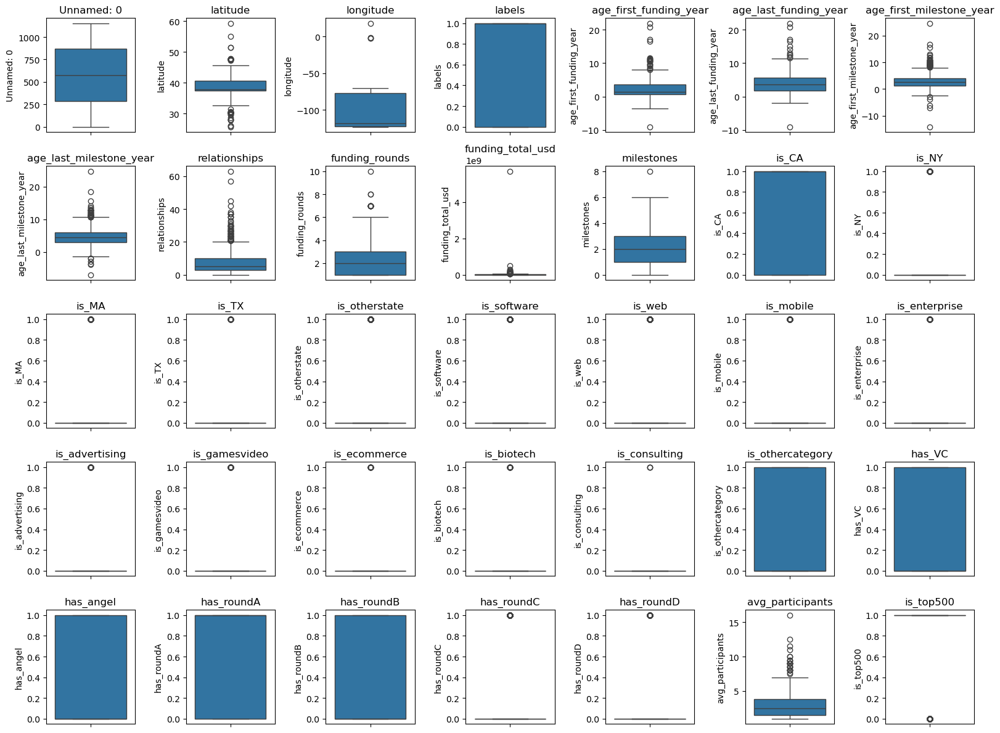

In [ ]:
numeric_cols = df.select_dtypes(include=['number']).columns

plt.figure(figsize=(16, 12))
for i, col in enumerate(numeric_cols, 1):
    if i > 35:
        break
    plt.subplot(5, 7, i)
    sns.boxplot(y=df[col])
    plt.title(col)
    plt.xticks(rotation=45)

plt.tight_layout()
plt.show()


#  Target vs Features

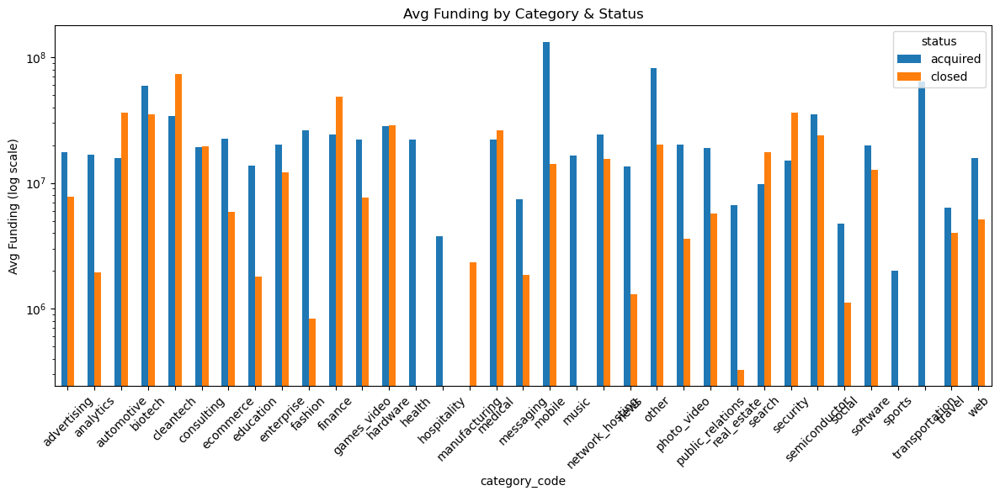

In [ ]:
# Average funding by category and status
pivot = df.pivot_table(index='category_code', columns='status', values='funding_total_usd', aggfunc='mean')
pivot.plot(kind='bar', figsize=(12, 6), logy=True)
plt.title("Avg Funding by Category & Status")
plt.ylabel("Avg Funding (log scale)")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


# Linearity Check - Status vs. Key Features

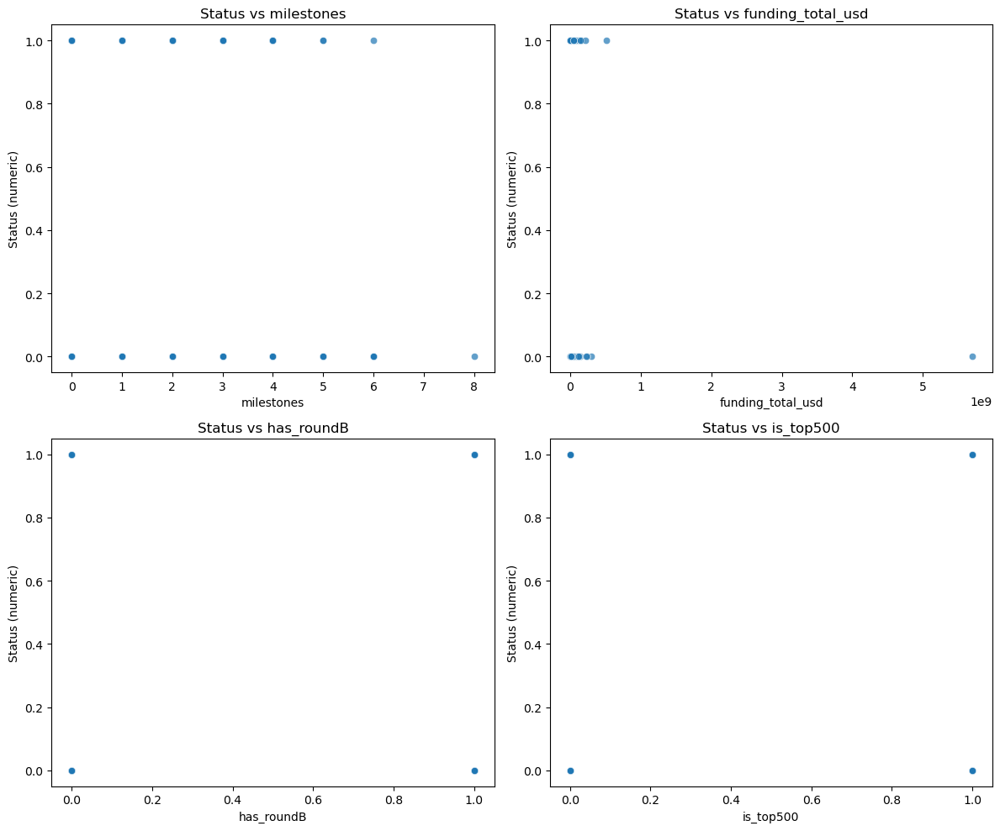

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import LabelEncoder

# Step 1: Define columns to check
cols_to_check = ['milestones', 'funding_total_usd', 'has_roundB', 'is_top500']

# Step 2: Check if 'status_numeric' exists; if not, create it from 'status'
if 'status_numeric' not in df.columns:
    if 'status' in df.columns:
        le = LabelEncoder()
        df['status_numeric'] = le.fit_transform(df['status'])
    else:
        raise KeyError("'status' column not found to create 'status_numeric'.")

# Step 3: Check for missing columns
missing_cols = [col for col in cols_to_check if col not in df.columns]
if missing_cols:
    print(f"⚠️ Warning: The following columns are missing: {missing_cols}")
else:
    # Step 4: Drop rows with missing values in required columns
    df = df.dropna(subset=cols_to_check + ['status_numeric'])
    
    # Step 5: Convert columns to numeric if needed
    for col in cols_to_check:
        df[col] = pd.to_numeric(df[col], errors='coerce')

    # Step 6: Create scatter plots to analyze linearity
    plt.figure(figsize=(12, 10))
    for i, col in enumerate(cols_to_check, 1):
        plt.subplot(2, 2, i)
        sns.scatterplot(x=df[col], y=df['status_numeric'], alpha=0.7)
        plt.title(f"Status vs {col}")
        plt.xlabel(col)
        plt.ylabel("Status (numeric)")
    plt.tight_layout()
    plt.show()

# Distribution of Startup Status

status
acquired    597
closed      326
Name: count, dtype: int64


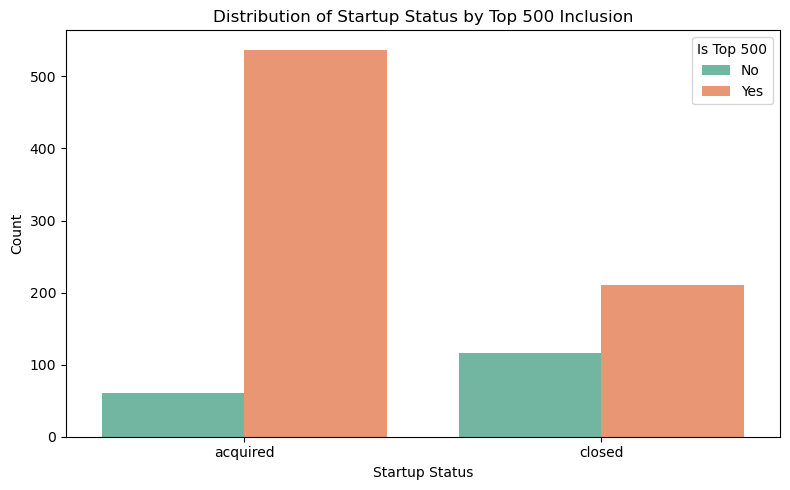

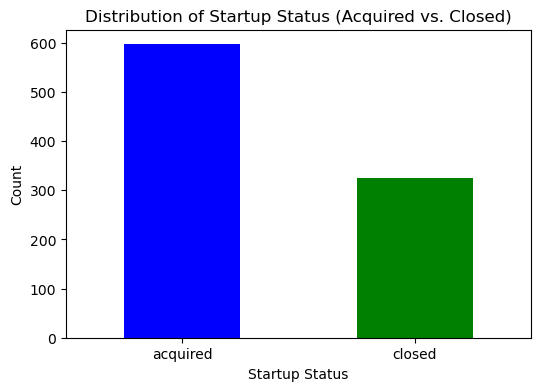

In [ ]:
print(df['status'].value_counts())

if 'is_top500' in df.columns:
    plt.figure(figsize=(8, 5))
    sns.countplot(data=df, x='status', hue='is_top500', palette='Set2')
    plt.xlabel("Startup Status")
    plt.ylabel("Count")
    plt.title("Distribution of Startup Status by Top 500 Inclusion")
    plt.legend(title="Is Top 500", labels=["No", "Yes"])
    plt.xticks(rotation=0)
    plt.tight_layout()
    plt.show()
else:
    print("⚠️ Column 'is_top500' not found in the dataset.")

plt.figure(figsize=(6, 4))
df['status'].value_counts().plot(kind='bar', color=['blue', 'green'])
plt.xlabel("Startup Status")
plt.ylabel("Count")
plt.title("Distribution of Startup Status (Acquired vs. Closed)")
plt.xticks(rotation=0)
plt.show()


# Distribution (Histogram + KDE) of All Numeric Features

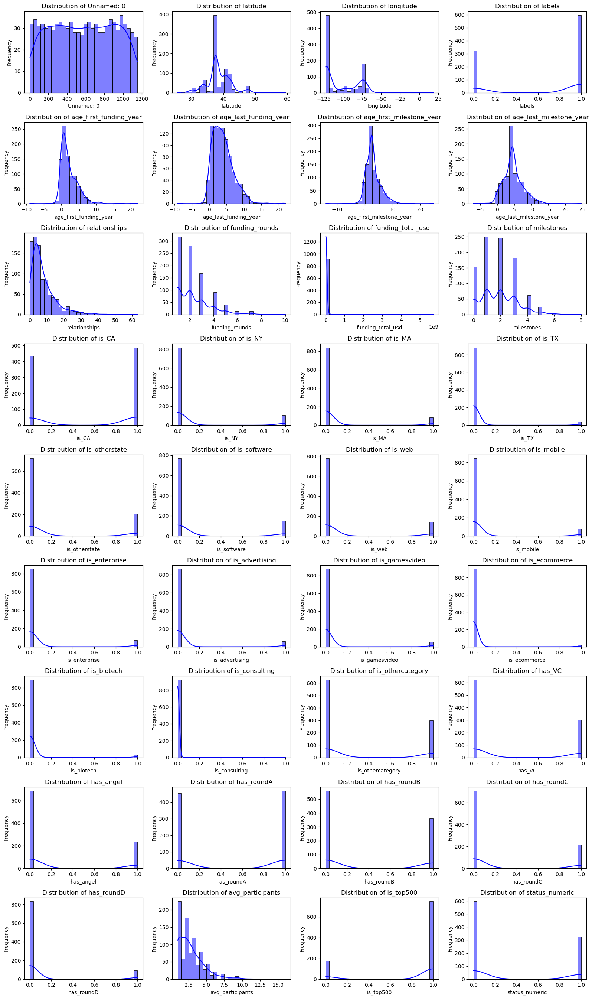

In [ ]:
numeric_cols = df.select_dtypes(include=[np.number]).columns
num_features = len(numeric_cols)
cols = 4
rows = math.ceil(num_features / cols)

plt.figure(figsize=(16, rows * 3))
for i, col in enumerate(numeric_cols, 1):
    plt.subplot(rows, cols, i)
    sns.histplot(df[col], bins=30, kde=True, color='blue')
    plt.title(f"Distribution of {col}")
    plt.xlabel(col)
    plt.ylabel("Frequency")
plt.tight_layout()
plt.show()


# Linear Discriminant Analysis (FLDA) with Cross-Validation))


FLDA Accuracy: 1.0

Confusion Matrix:
[[179   0]
 [  0  98]]

Classification Report:
              precision    recall  f1-score   support

    acquired       1.00      1.00      1.00       179
      closed       1.00      1.00      1.00        98

    accuracy                           1.00       277
   macro avg       1.00      1.00      1.00       277
weighted avg       1.00      1.00      1.00       277



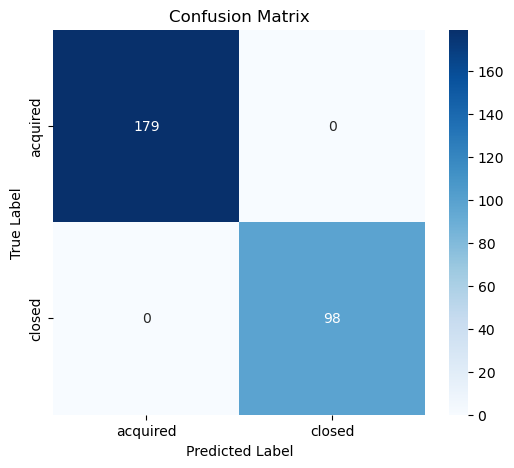

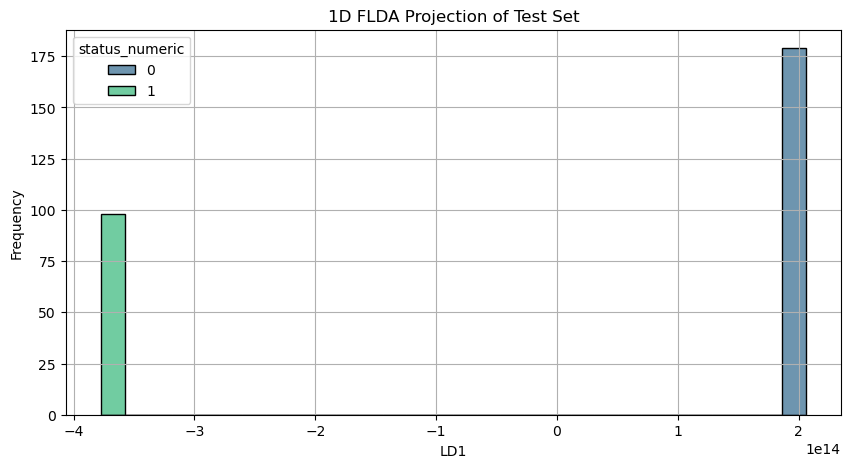


🔁 Cross-Validation Accuracy Scores (Original Data): [0.72972973 0.73513514 0.71891892 0.76630435 0.7173913 ]
🔁 Mean CV Accuracy: 0.7334958871915394


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\1820007572.py:72: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.stripplot(x=y_test, y=X_test_lda[:, 0], palette='viridis', jitter=0.2)


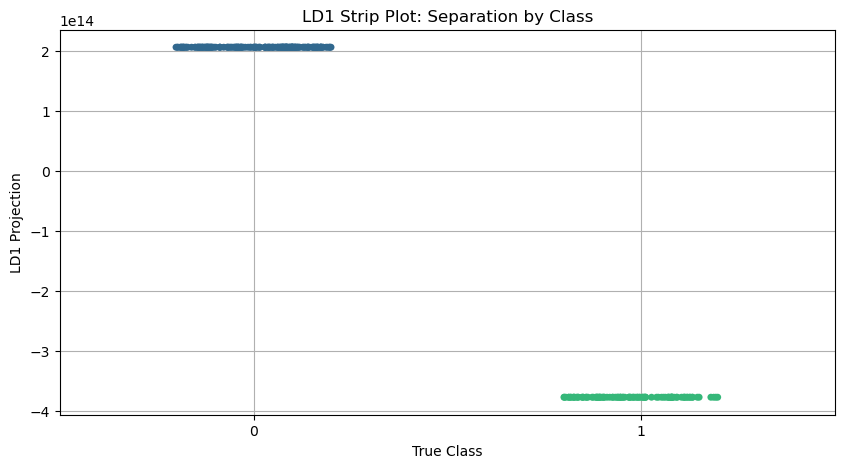

C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\1820007572.py:86: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=coeff_df, x='LDA Coefficient', y='Feature', palette='coolwarm')


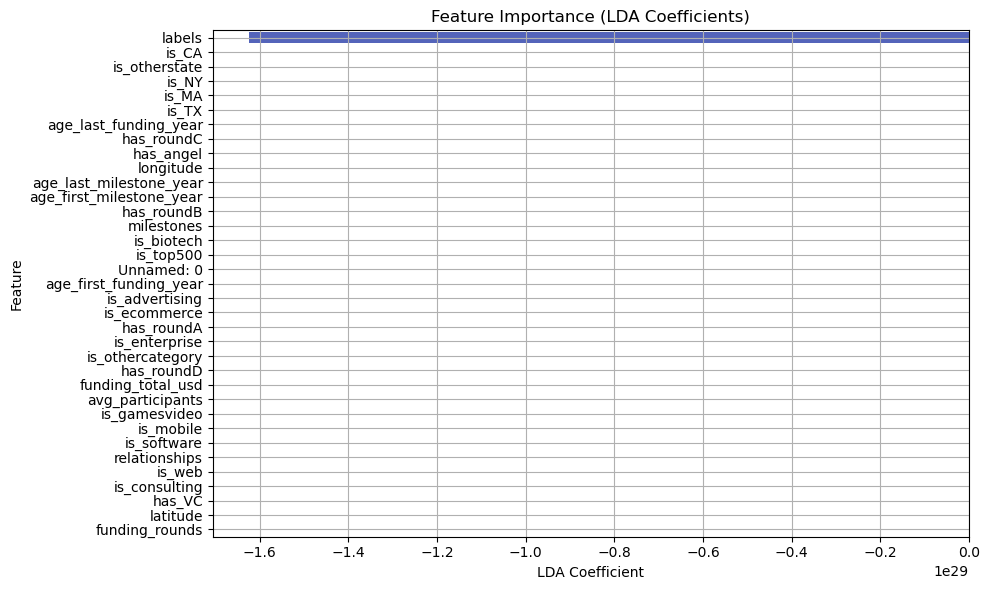

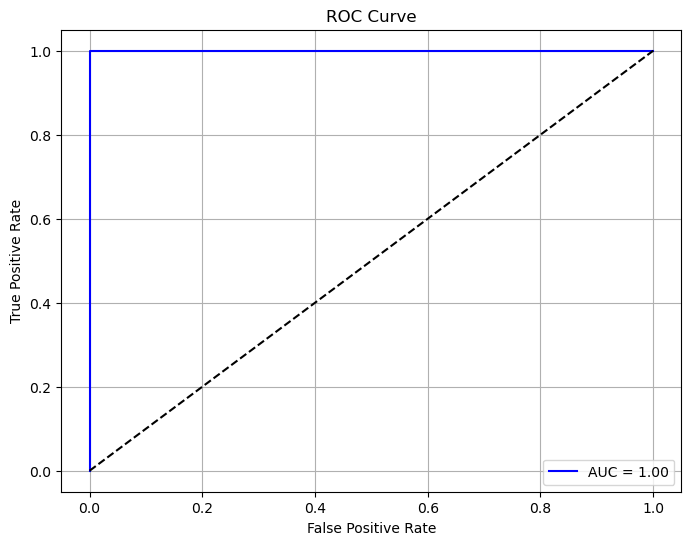

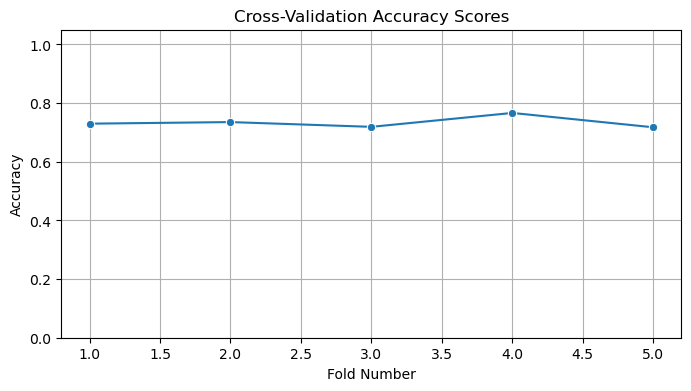

In [ ]:
# Import Libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, auc

le = LabelEncoder()
df['status_numeric'] = le.fit_transform(df['status'])

# Split features and target
features = df.select_dtypes(include=[np.number]).drop(columns=['status_numeric'])
target = df['status_numeric']

# Train-Test Split
X_train, X_test, y_train, y_test = train_test_split(features, target, test_size=0.3, random_state=42, stratify=target)

# Scaling
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Apply Linear Discriminant Analysis (LDA)
lda = LinearDiscriminantAnalysis(n_components=1)
lda.fit(X_train_scaled, y_train)

# Transform the features
X_train_lda = lda.transform(X_train_scaled)
X_test_lda = lda.transform(X_test_scaled)

# Prediction
y_pred = lda.predict(X_test_scaled)

# Evaluation
print("FLDA Accuracy:", accuracy_score(y_test, y_pred))
print("\nConfusion Matrix:")
cm = confusion_matrix(y_test, y_pred)
print(cm)
print("\nClassification Report:")
print(classification_report(y_test, y_pred, target_names=le.classes_))

# Plot Confusion Matrix
plt.figure(figsize=(6, 5))
sns.heatmap(cm, annot=True, fmt="d", cmap="Blues", 
            xticklabels=le.classes_, 
            yticklabels=le.classes_)
plt.xlabel("Predicted Label")
plt.ylabel("True Label")
plt.title("Confusion Matrix")
plt.show()

# Plot 1D FLDA Projection
plt.figure(figsize=(10, 5))
sns.histplot(x=X_test_lda[:, 0], hue=y_test, bins=30, palette='viridis', alpha=0.7)
plt.title("1D FLDA Projection of Test Set")
plt.xlabel("LD1")
plt.ylabel("Frequency")
plt.grid(True)
plt.show()

# Cross-Validation
lda_cv = LinearDiscriminantAnalysis(n_components=1)
cv_scores = cross_val_score(lda_cv, features, target, cv=5, scoring='accuracy')
print("\n🔁 Cross-Validation Accuracy Scores (Original Data):", cv_scores)
print("🔁 Mean CV Accuracy:", np.mean(cv_scores))

# Strip plot (LD1 separation)
plt.figure(figsize=(10, 5))
sns.stripplot(x=y_test, y=X_test_lda[:, 0], palette='viridis', jitter=0.2)
plt.title("LD1 Strip Plot: Separation by Class")
plt.xlabel("True Class")
plt.ylabel("LD1 Projection")
plt.grid(True)
plt.show()

# Feature Importance (Coefficients)
coeff_df = pd.DataFrame({
    'Feature': features.columns,
    'LDA Coefficient': lda.coef_[0]
}).sort_values(by='LDA Coefficient', key=abs, ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(data=coeff_df, x='LDA Coefficient', y='Feature', palette='coolwarm')
plt.title("Feature Importance (LDA Coefficients)")
plt.grid(True)
plt.tight_layout()
plt.show()

# ROC Curve
y_proba = lda.predict_proba(X_test_scaled)[:, 1]
fpr, tpr, _ = roc_curve(y_test, y_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f"AUC = {roc_auc:.2f}", color='blue')
plt.plot([0, 1], [0, 1], 'k--')
plt.title("ROC Curve")
plt.xlabel("False Positive Rate")
plt.ylabel("True Positive Rate")
plt.legend()
plt.grid(True)
plt.show()

# Cross-validation scores plot
plt.figure(figsize=(8, 4))
sns.lineplot(x=range(1, 6), y=cv_scores, marker='o')
plt.title("Cross-Validation Accuracy Scores")
plt.xlabel("Fold Number")
plt.ylabel("Accuracy")
plt.ylim(0, 1.05)
plt.grid(True)
plt.show()


# LOGISTIC REGRESSION - Classification

C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\linear_model\_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(



📋 Model Evaluation Metrics:
Accuracy: 0.8108
Precision: 0.9412
Recall (Sensitivity): 0.4923
F1 Score: 0.6465

Classification Report:
              precision    recall  f1-score   support

           0       0.78      0.98      0.87       120
           1       0.94      0.49      0.65        65

    accuracy                           0.81       185
   macro avg       0.86      0.74      0.76       185
weighted avg       0.84      0.81      0.79       185



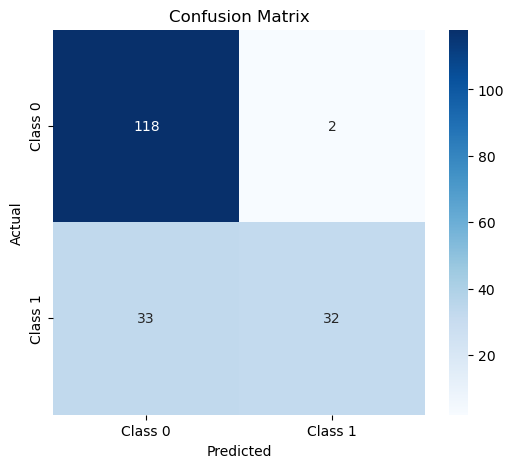

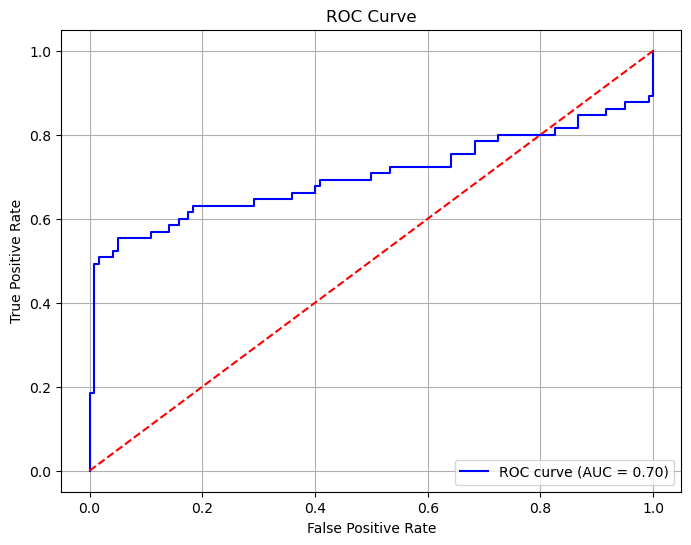

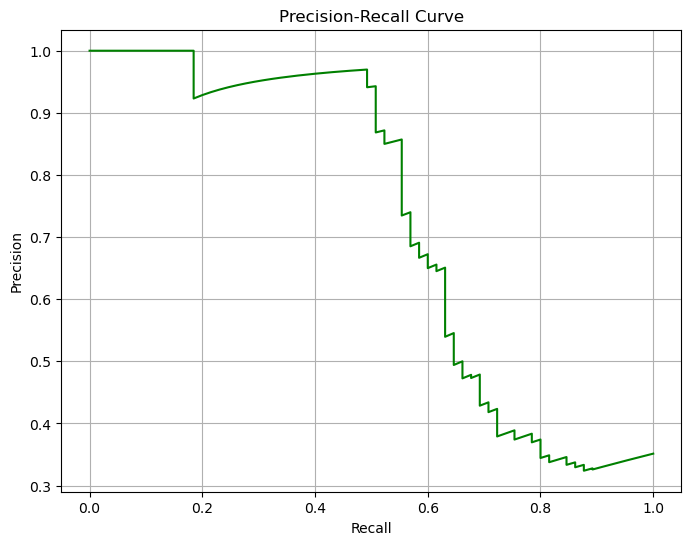

C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\636985021.py:95: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='Coefficient', y='Feature', data=coef_df, palette='coolwarm')


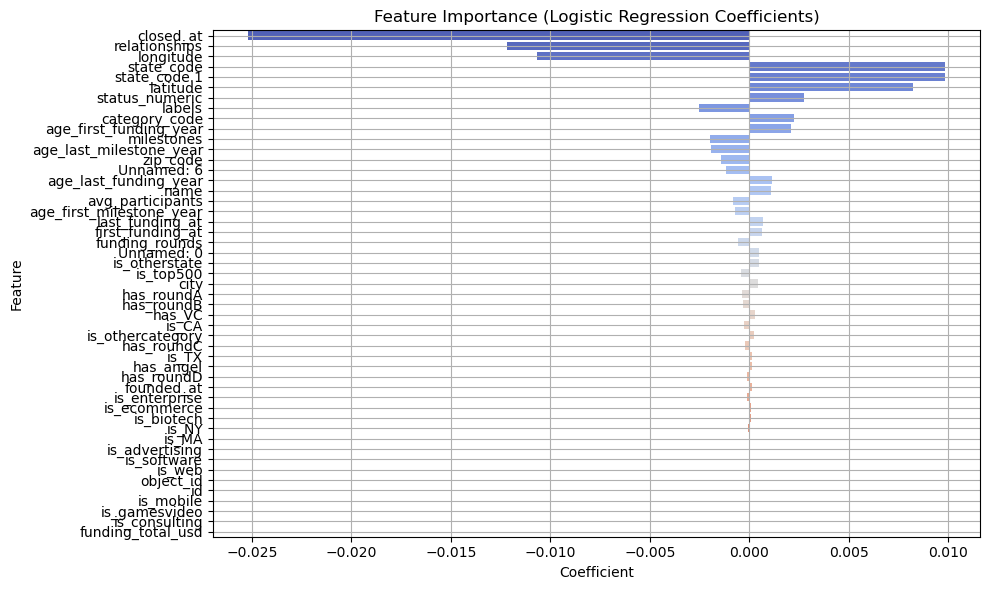

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import (accuracy_score, precision_score, recall_score, f1_score, confusion_matrix, classification_report,
                             roc_curve, auc, precision_recall_curve)

X = df.drop('status', axis=1)
y = df['status']

# --- Encode Categorical Features ---
# Automatically encode non-numeric columns
for col in X.columns:
    if X[col].dtype == 'object':
        le = LabelEncoder()
        X[col] = le.fit_transform(X[col])

# --- Encode target if it's categorical ---
if y.dtype == 'object':
    le_target = LabelEncoder()
    y = le_target.fit_transform(y)

# --- Train-Test Split ---
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

# --- Model Training ---
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

# --- Predictions ---
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)[:, 1]

# --- Evaluation Metrics ---
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)

print("\n📋 Model Evaluation Metrics:")
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall (Sensitivity): {recall:.4f}")
print(f"F1 Score: {f1:.4f}")

# --- Classification Report ---
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

# --- Confusion Matrix ---
cm = confusion_matrix(y_test, y_pred)

plt.figure(figsize=(6,5))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Class 0','Class 1'], yticklabels=['Class 0','Class 1'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()

# --- ROC Curve ---
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)
roc_auc = auc(fpr, tpr)

plt.figure(figsize=(8,6))
plt.plot(fpr, tpr, color='blue', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='red', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend(loc="lower right")
plt.grid(True)
plt.show()

# --- Precision-Recall Curve ---
precision_vals, recall_vals, _ = precision_recall_curve(y_test, y_pred_proba)

plt.figure(figsize=(8,6))
plt.plot(recall_vals, precision_vals, color='green')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Precision-Recall Curve')
plt.grid(True)
plt.show()

# --- Feature Importance (Coefficients) ---
coef_df = pd.DataFrame({
    'Feature': X.columns,
    'Coefficient': model.coef_[0]
}).sort_values(by='Coefficient', key=abs, ascending=False)

plt.figure(figsize=(10,6))
sns.barplot(x='Coefficient', y='Feature', data=coef_df, palette='coolwarm')
plt.title('Feature Importance (Logistic Regression Coefficients)')
plt.grid(True)
plt.tight_layout()
plt.show()

# PRINCIPAL COMPONENT ANALYSIS AND FACTOR ANALYSIS


Explained Variance Ratio (By Principal Component):
PC1: 0.1226 (12.26%)
PC2: 0.0878 (8.78%)
PC3: 0.0747 (7.47%)
PC4: 0.0462 (4.62%)
PC5: 0.0437 (4.37%)
PC6: 0.0408 (4.08%)
PC7: 0.0391 (3.91%)
PC8: 0.0353 (3.53%)
PC9: 0.0347 (3.47%)
PC10: 0.0325 (3.25%)
PC11: 0.0320 (3.20%)
PC12: 0.0312 (3.12%)
PC13: 0.0301 (3.01%)
PC14: 0.0298 (2.98%)
PC15: 0.0285 (2.85%)
PC16: 0.0279 (2.79%)
PC17: 0.0271 (2.71%)
PC18: 0.0267 (2.67%)
PC19: 0.0247 (2.47%)
PC20: 0.0242 (2.42%)
PC21: 0.0230 (2.30%)
PC22: 0.0207 (2.07%)
PC23: 0.0196 (1.96%)
PC24: 0.0173 (1.73%)
PC25: 0.0152 (1.52%)
PC26: 0.0145 (1.45%)
PC27: 0.0128 (1.28%)
PC28: 0.0112 (1.12%)
PC29: 0.0102 (1.02%)
PC30: 0.0050 (0.50%)
PC31: 0.0047 (0.47%)
PC32: 0.0043 (0.43%)
PC33: 0.0019 (0.19%)
PC34: 0.0000 (0.00%)
PC35: 0.0000 (0.00%)
PC36: 0.0000 (0.00%)


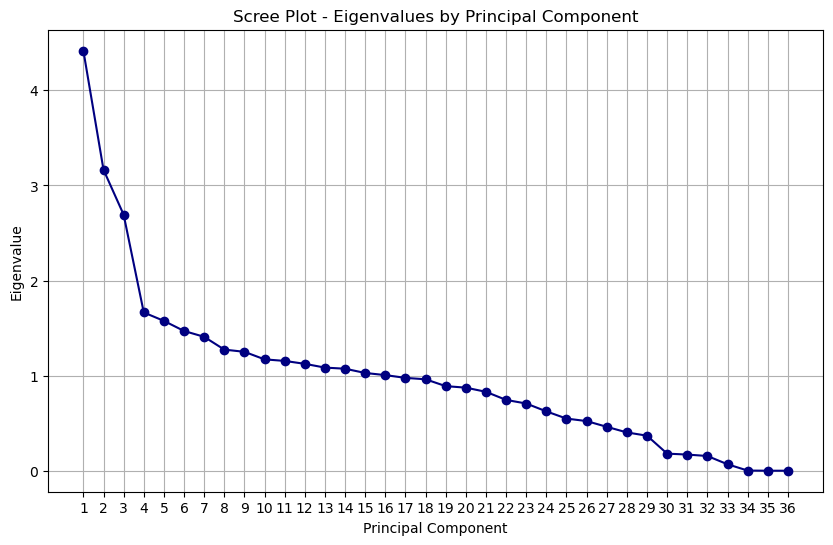

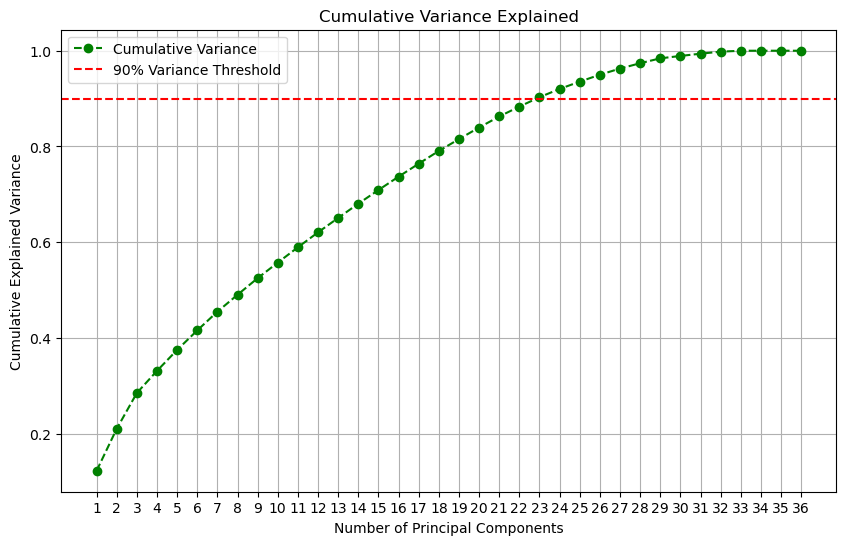


Optimal number of components to retain at least 90% variance: 23

PCA Reduced Data (First 5 Rows):
        PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
0  0.869729 -0.327918  0.413892  1.025104  0.888243  0.730375  1.262323   
1 -4.441453  1.675163 -0.691681 -0.275417 -0.964561 -0.316548  1.118249   
2  0.835093 -1.995623 -1.905759  1.365334  1.035107 -0.177131 -0.637073   
3 -2.845646  0.971219 -1.018840  0.777100 -0.416262 -1.221233 -0.719621   
4  3.014244 -0.290710 -1.754055 -0.563802 -1.828941 -0.687199  0.758565   

        PC8       PC9      PC10  ...      PC14      PC15      PC16      PC17  \
0  0.342598 -0.620100  0.083977  ... -1.689333 -0.488233  0.269527  0.865070   
1  1.417015  1.380404 -1.411959  ... -0.709768 -0.350691  0.213747 -0.447392   
2  0.338529  0.829955  0.506338  ...  0.844963  0.373671 -0.549292 -0.388757   
3 -0.343096  1.145197 -0.324273  ... -0.031302 -0.734613  0.331210  0.686860   
4 -1.373796  1.792747 -2.336895  ... -1.169062  0

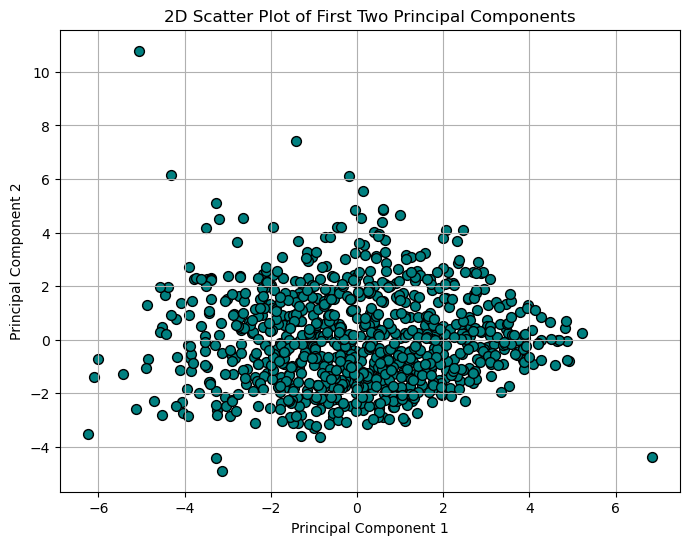

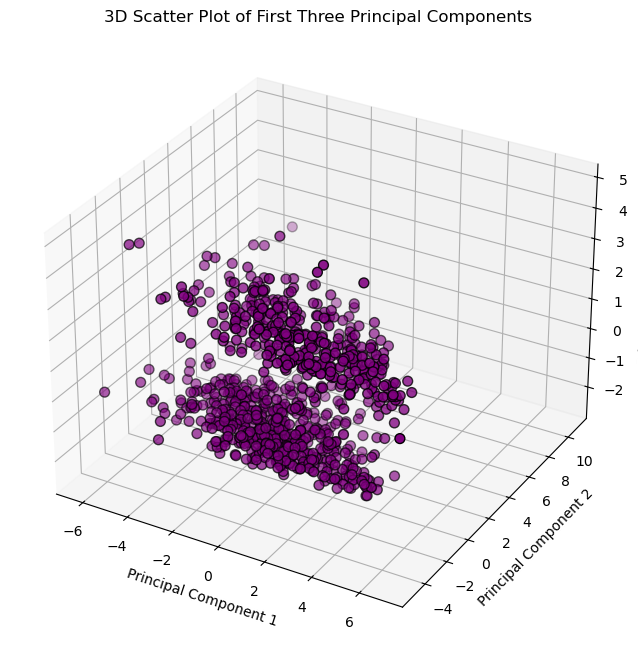


==== Top Feature Contributions to Each Principal Component ====

Top contributing features for PC1:
age_last_milestone_year     0.697306
age_last_funding_year       0.646938
age_first_milestone_year    0.625025
funding_rounds              0.574480
labels                      0.557961
Name: PC1, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


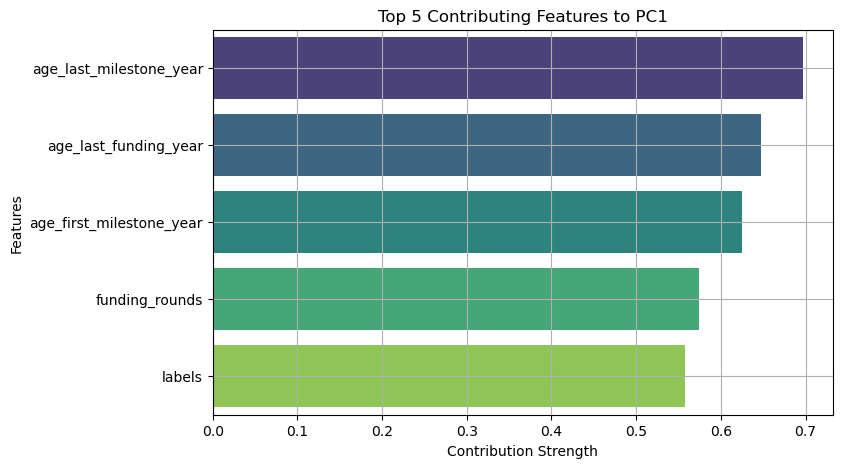


Top contributing features for PC2:
age_first_funding_year    0.765111
age_last_funding_year     0.624483
milestones                0.620199
has_roundA                0.475627
relationships             0.452311
Name: PC2, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


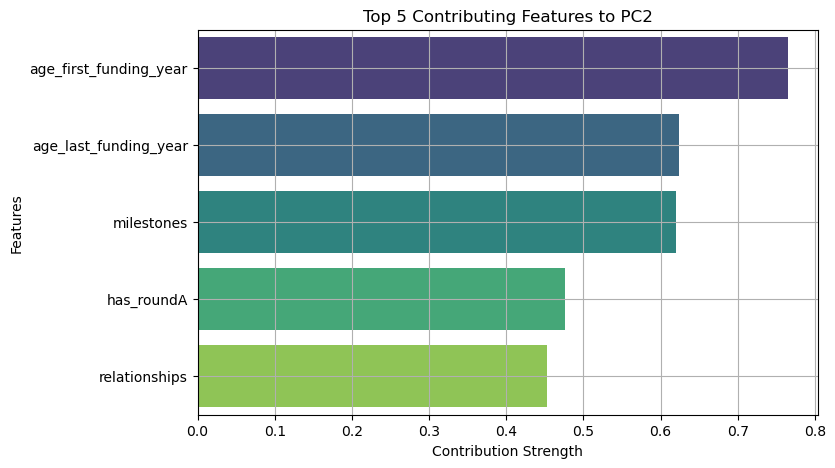


Top contributing features for PC3:
is_CA        0.851036
longitude    0.839716
latitude     0.666200
is_MA        0.498933
is_NY        0.432878
Name: PC3, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


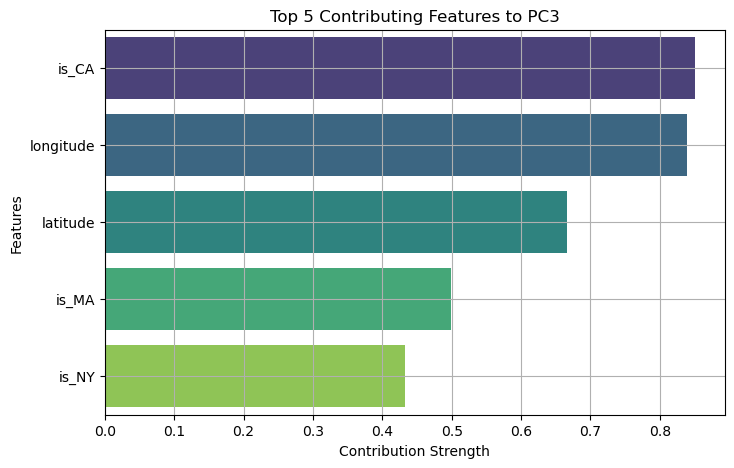


Top contributing features for PC4:
avg_participants    0.507441
labels              0.446189
status_numeric      0.446189
funding_rounds      0.401467
has_roundA          0.291364
Name: PC4, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


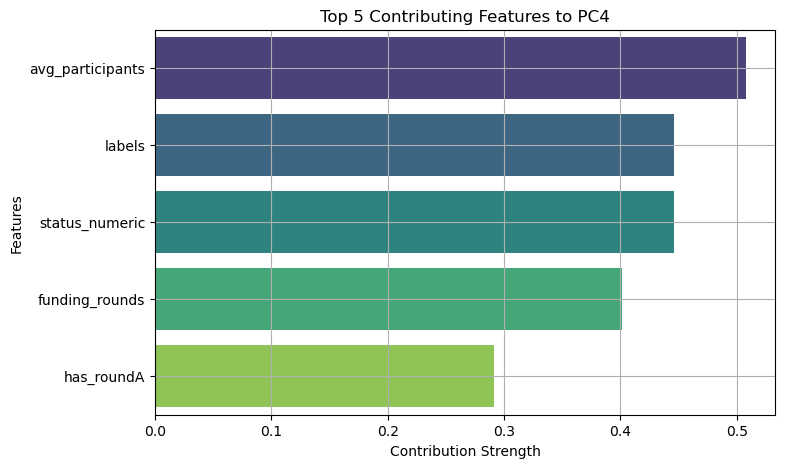


Top contributing features for PC5:
age_last_milestone_year     0.456025
age_first_milestone_year    0.444902
is_web                      0.429000
is_othercategory            0.391507
funding_rounds              0.389834
Name: PC5, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


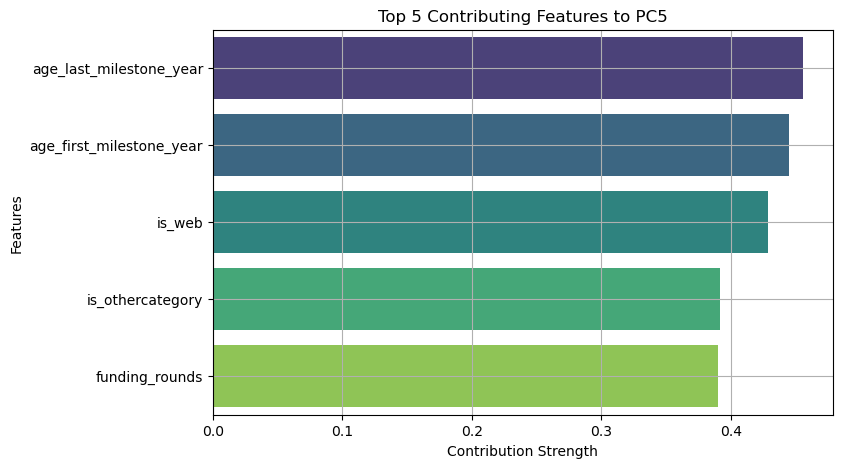


Top contributing features for PC6:
is_TX               0.658802
is_othercategory    0.429028
latitude            0.402047
is_NY               0.366154
is_software         0.346112
Name: PC6, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


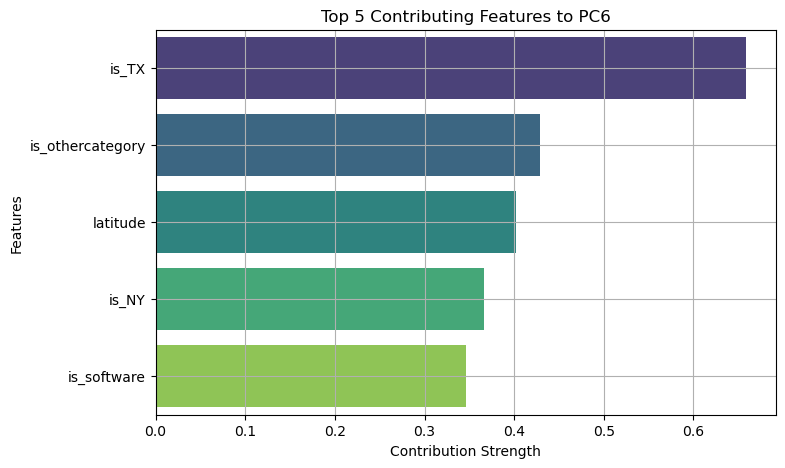


Top contributing features for PC7:
is_software    0.533334
is_TX          0.475764
is_MA          0.363680
has_angel      0.331691
has_roundA     0.251534
Name: PC7, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


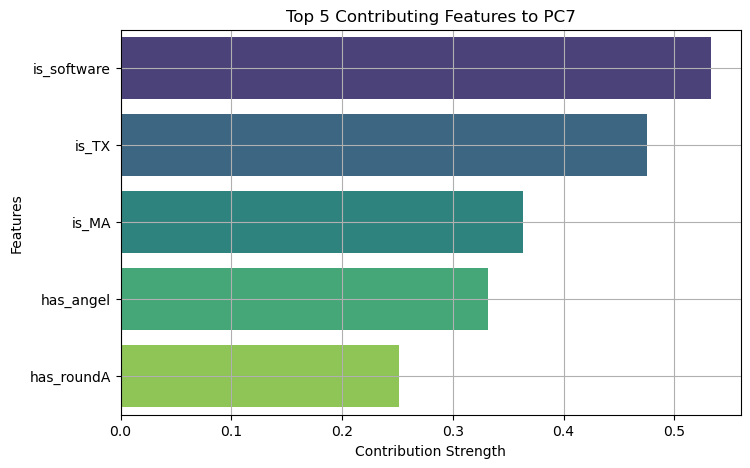


Top contributing features for PC8:
is_enterprise     0.501160
is_otherstate     0.438668
is_gamesvideo     0.390853
is_NY             0.383795
status_numeric    0.301319
Name: PC8, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


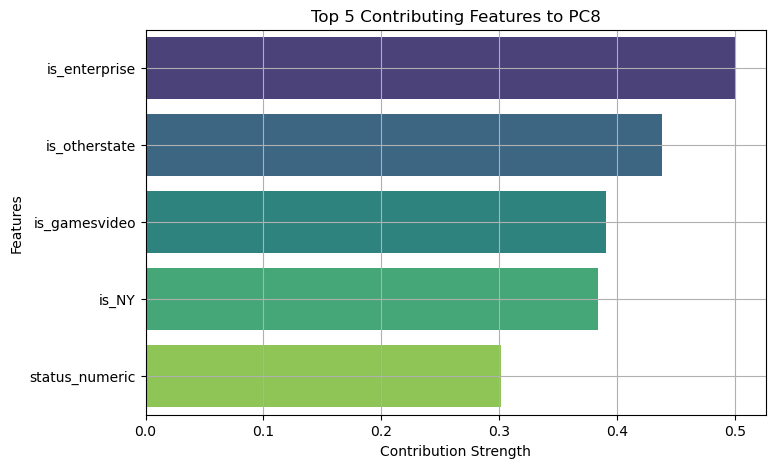


Top contributing features for PC9:
is_othercategory    0.598934
is_mobile           0.298662
is_biotech          0.280284
is_advertising      0.278554
Unnamed: 0          0.246852
Name: PC9, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


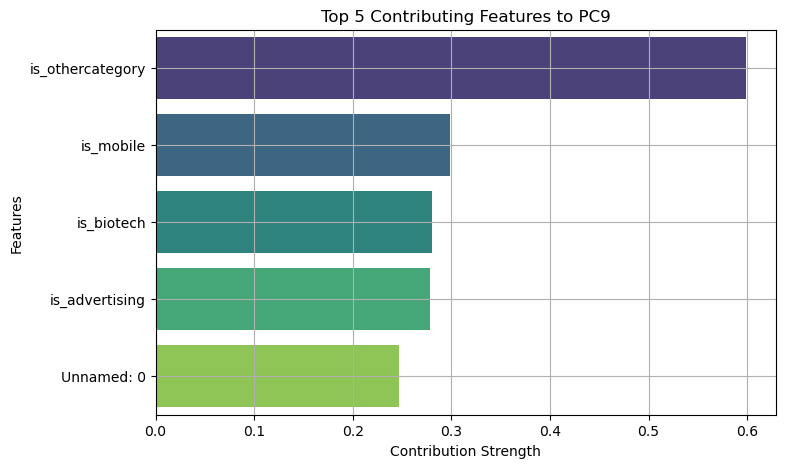


Top contributing features for PC10:
is_gamesvideo    0.548450
is_enterprise    0.468889
is_mobile        0.374729
is_MA            0.331180
Unnamed: 0       0.319581
Name: PC10, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


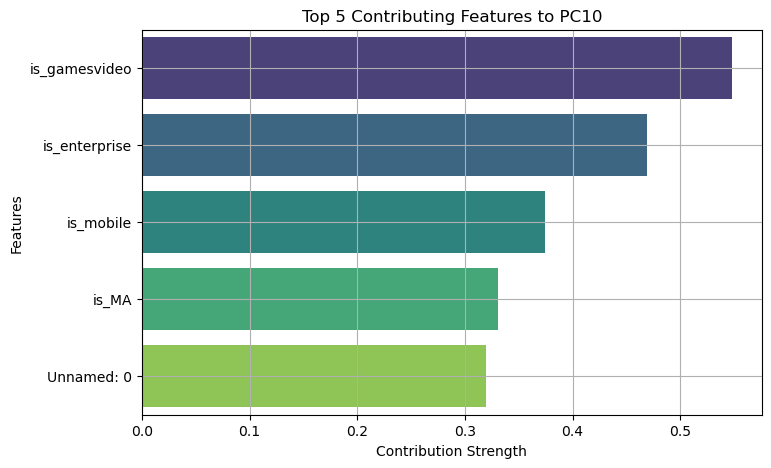


Top contributing features for PC11:
is_advertising    0.521836
Unnamed: 0        0.411321
is_web            0.377276
is_MA             0.274977
is_biotech        0.269125
Name: PC11, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


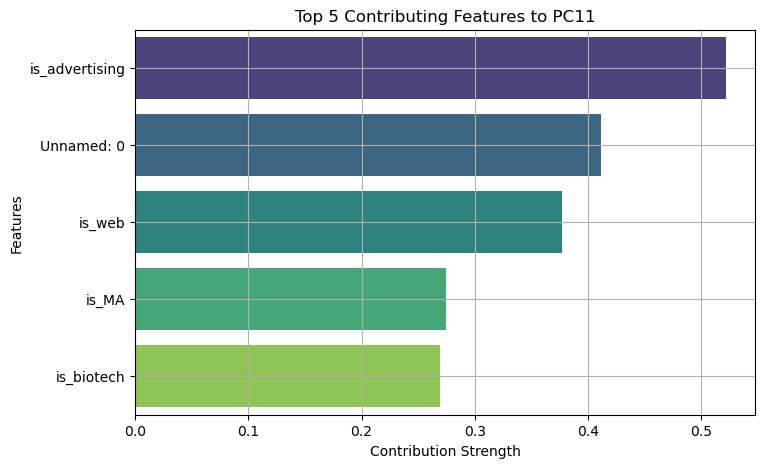


Top contributing features for PC12:
is_mobile            0.573594
funding_total_usd    0.310886
is_biotech           0.304167
is_web               0.301050
is_enterprise        0.279492
Name: PC12, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


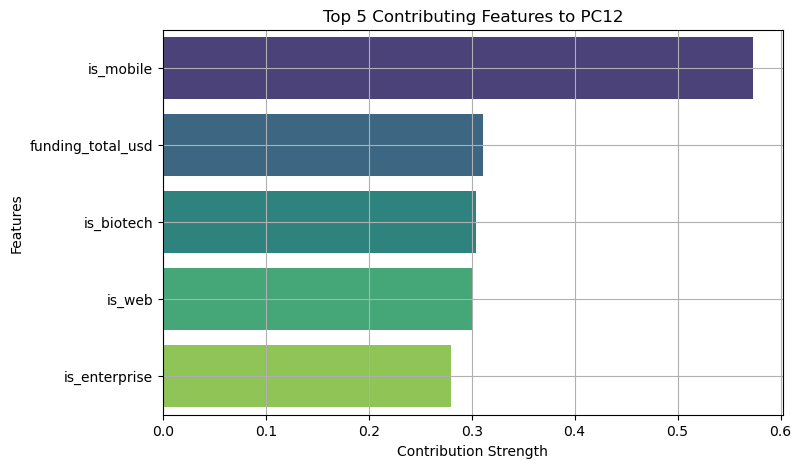


Top contributing features for PC13:
is_software      0.553520
is_biotech       0.419046
has_roundD       0.360872
is_enterprise    0.261057
is_ecommerce     0.244922
Name: PC13, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


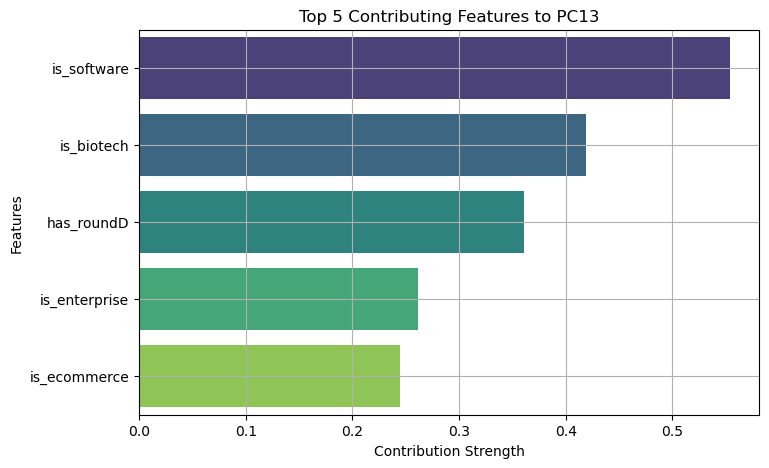


Top contributing features for PC14:
has_VC               0.385229
is_biotech           0.377094
funding_total_usd    0.334157
is_advertising       0.314304
is_otherstate        0.283973
Name: PC14, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


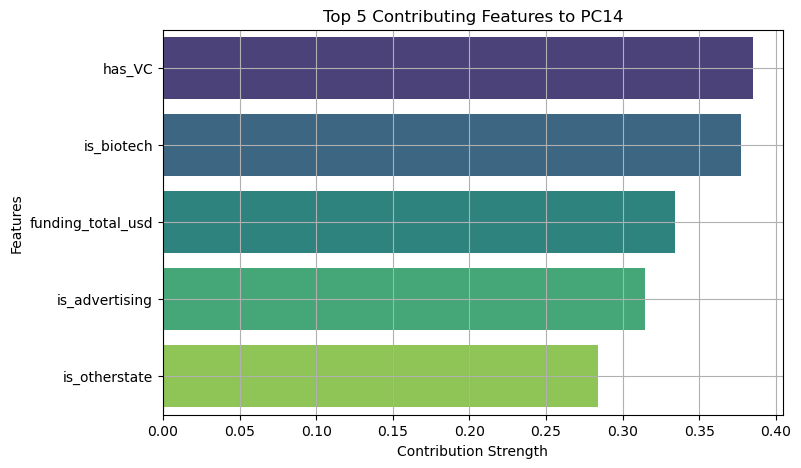


Top contributing features for PC15:
is_ecommerce         0.637989
is_consulting        0.444031
is_advertising       0.381153
has_VC               0.287893
funding_total_usd    0.142002
Name: PC15, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


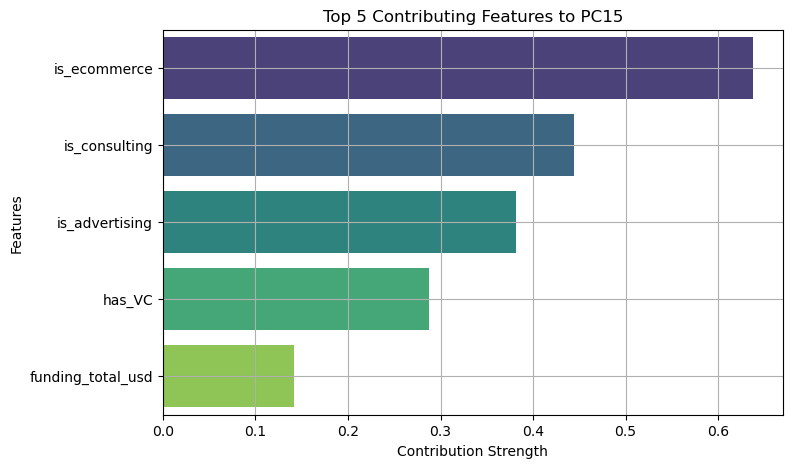


Top contributing features for PC16:
is_ecommerce    0.469968
has_VC          0.418065
is_web          0.388308
is_MA           0.246373
is_NY           0.227373
Name: PC16, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


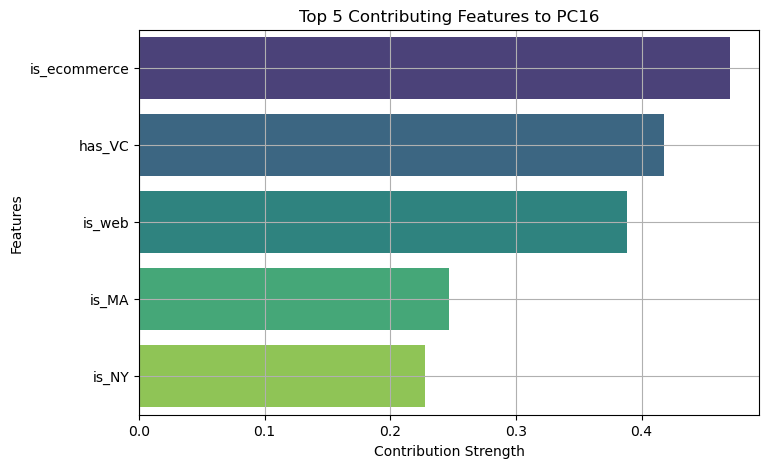


Top contributing features for PC17:
is_consulting    0.600795
is_gamesvideo    0.397175
is_ecommerce     0.351692
is_otherstate    0.210630
is_NY            0.210096
Name: PC17, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


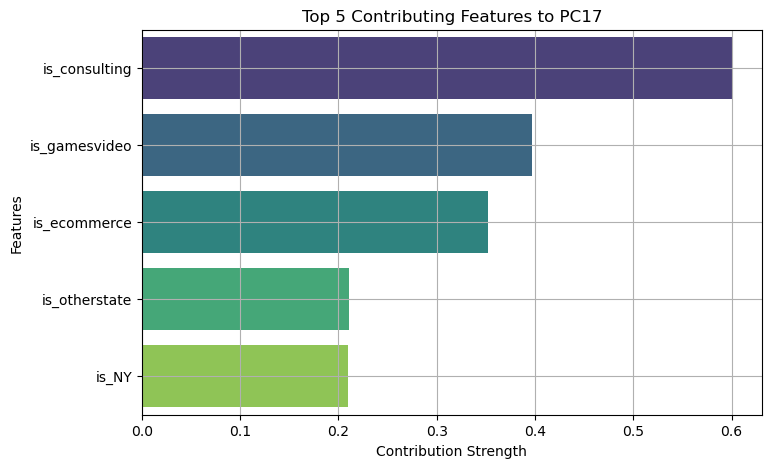


Top contributing features for PC18:
avg_participants    0.460159
is_top500           0.359085
is_advertising      0.332382
is_consulting       0.323624
is_MA               0.216820
Name: PC18, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


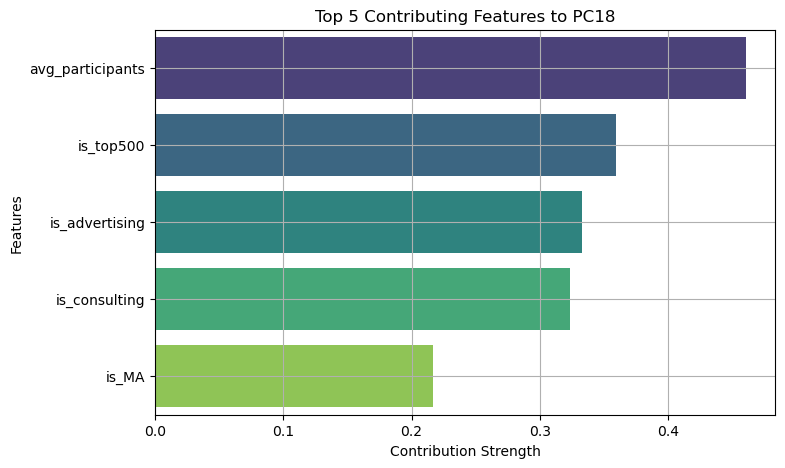


Top contributing features for PC19:
funding_total_usd    0.639429
is_mobile            0.413911
is_MA                0.229819
has_roundD           0.194960
has_VC               0.175924
Name: PC19, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


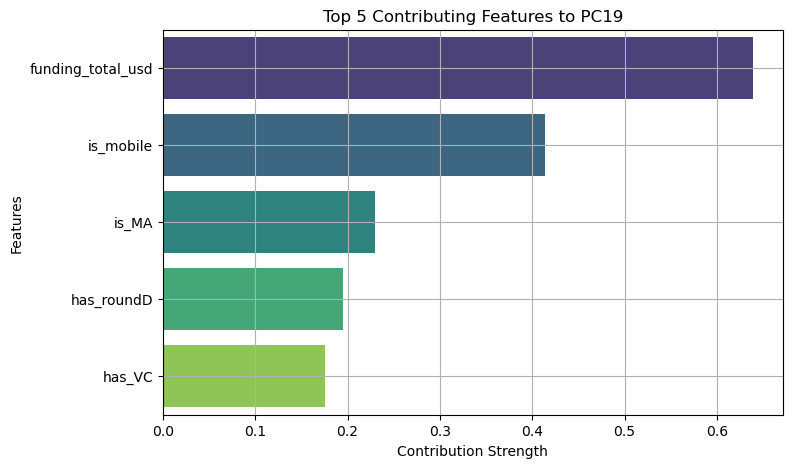


Top contributing features for PC20:
is_enterprise    0.462542
Unnamed: 0       0.446547
is_biotech       0.291125
is_NY            0.223408
is_otherstate    0.211952
Name: PC20, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


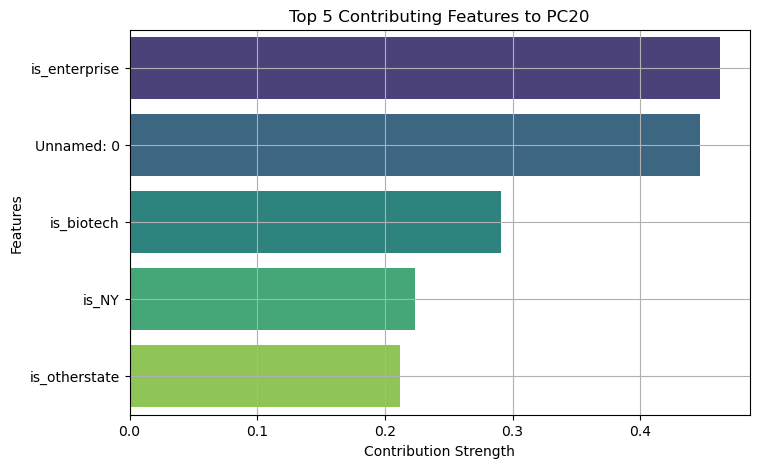


Top contributing features for PC21:
is_gamesvideo    0.372438
is_NY            0.293844
is_biotech       0.285426
has_angel        0.258324
is_software      0.228312
Name: PC21, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


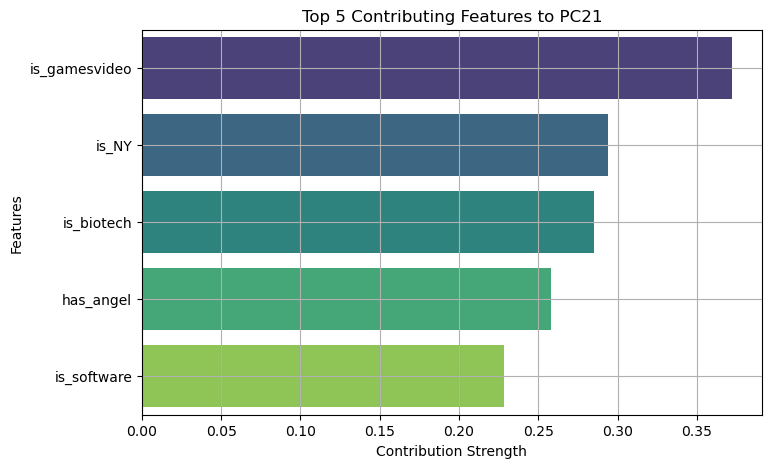


Top contributing features for PC22:
has_angel           0.408675
has_roundC          0.379762
Unnamed: 0          0.335527
avg_participants    0.254416
is_NY               0.207253
Name: PC22, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


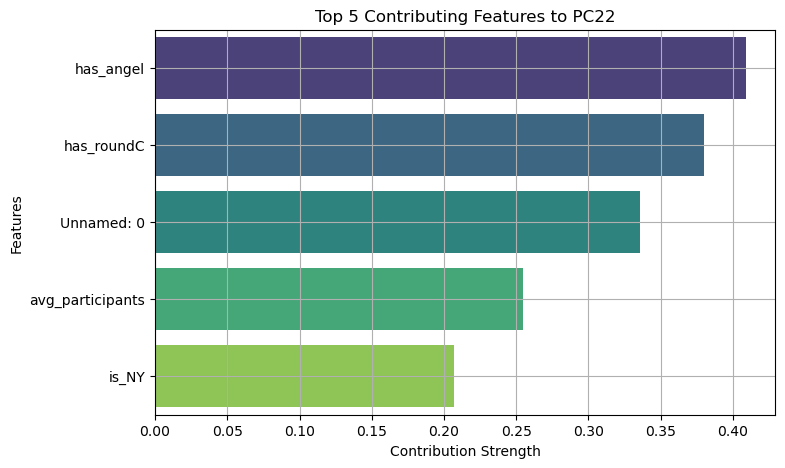


Top contributing features for PC23:
has_roundD    0.425821
has_roundB    0.395339
has_roundA    0.369703
has_roundC    0.254037
has_angel     0.232564
Name: PC23, dtype: float64


C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:113: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")


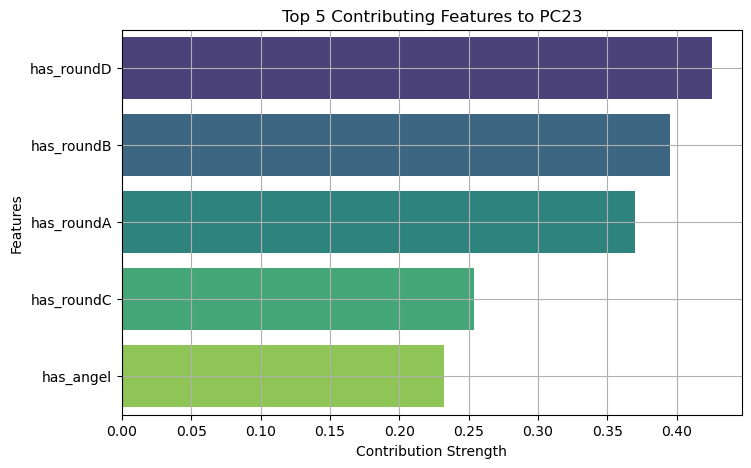


==== Factor Loadings Table ====
                             PC1     PC2     PC3     PC4     PC5     PC6  \
Unnamed: 0                0.1999 -0.0245  0.0211  0.2376 -0.0706 -0.0247   
latitude                  0.1159  0.0102  0.6662  0.1569 -0.0273 -0.4020   
longitude                 0.1951  0.0945  0.8397  0.0201 -0.0250  0.2400   
labels                   -0.5580 -0.4469  0.1641  0.4462  0.1407 -0.0569   
age_first_funding_year   -0.2840  0.7651 -0.0544  0.2279  0.2574  0.0632   
age_last_funding_year    -0.6469  0.6245  0.0689 -0.0445  0.0404  0.0389   
age_first_milestone_year -0.6250  0.3744  0.0382 -0.0418  0.4449  0.1164   
age_last_milestone_year  -0.6973  0.1957  0.0540 -0.0946  0.4560  0.1372   
relationships            -0.5483 -0.4523  0.0797 -0.1712  0.0885  0.1254   
funding_rounds           -0.5745 -0.1367  0.1952 -0.4015 -0.3898 -0.0032   
funding_total_usd        -0.1425  0.0537  0.0409 -0.1066 -0.0074  0.0779   
milestones               -0.3102 -0.6202  0.1392 -0.158

C:\Users\Locini\AppData\Local\Temp\ipykernel_13616\788542685.py:139: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=communality_df.index, y='Communality', data=communality_df, palette="coolwarm")


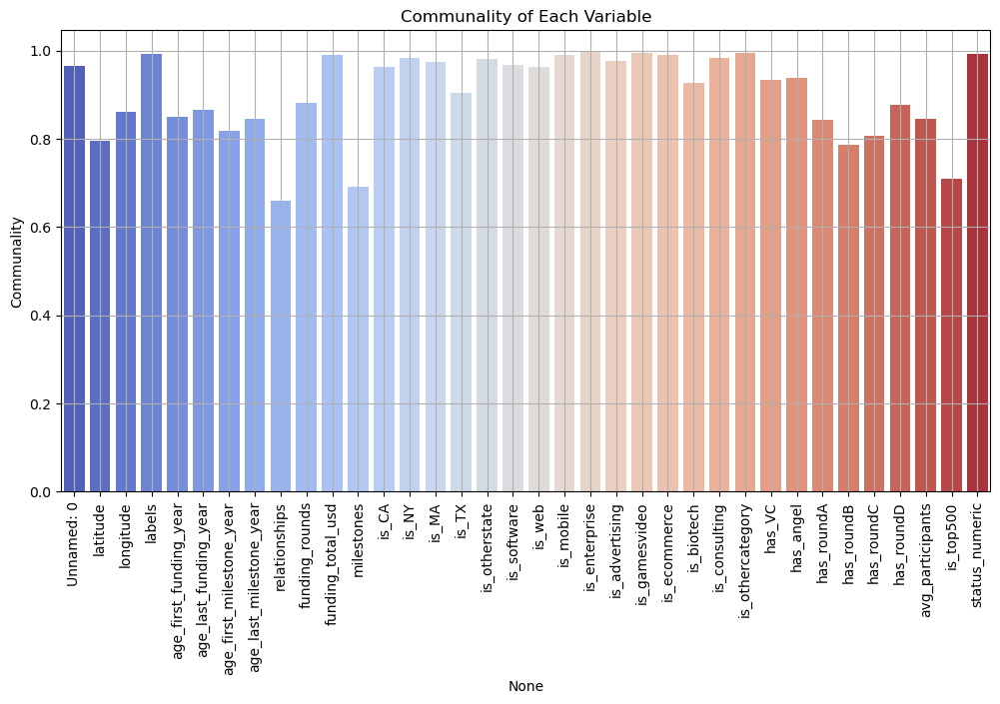

In [ ]:
# ====== PCA Analysis with Detailed Steps and Visualization ======

# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from mpl_toolkits.mplot3d import Axes3D

# STEP 1: Load and Prepare Data
df_numeric = df.select_dtypes(include=[np.number])

# Handle missing values if any
df_numeric.interpolate(inplace=True)

# STEP 2: Standardize Data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_numeric)

# STEP 3: Apply PCA
pca = PCA()
pca_data = pca.fit_transform(scaled_data)

# STEP 4: Analyze Variance
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display explained variance ratios
print("\nExplained Variance Ratio (By Principal Component):")
for i, var in enumerate(explained_variance_ratio, 1):
    print(f"PC{i}: {var:.4f} ({var*100:.2f}%)")

# STEP 5: Scree Plot (Eigenvalues)
plt.figure(figsize=(10, 6))
x_vals = range(1, len(eigenvalues) + 1)
plt.plot(x_vals, eigenvalues, marker='o', linestyle='-', color='navy')
plt.title('Scree Plot - Eigenvalues by Principal Component')
plt.xlabel('Principal Component')
plt.ylabel('Eigenvalue')
plt.xticks(x_vals)
plt.grid(True)
plt.show()

# STEP 6: Cumulative Explained Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(x_vals, cumulative_variance, marker='o', linestyle='--', color='green', label='Cumulative Variance')
plt.axhline(y=0.90, color='r', linestyle='--', label='90% Variance Threshold')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Variance Explained')
plt.xticks(x_vals)
plt.legend()
plt.grid(True)
plt.show()

# STEP 7: Determine Optimal Number of Components
optimal_components = np.argmax(cumulative_variance >= 0.90) + 1
print(f"\nOptimal number of components to retain at least 90% variance: {optimal_components}")

# STEP 8: PCA with Optimal Components
pca_final = PCA(n_components=optimal_components)
reduced_data = pca_final.fit_transform(scaled_data)

# Create DataFrame
pca_columns = [f"PC{i+1}" for i in range(optimal_components)]
pca_df = pd.DataFrame(reduced_data, columns=pca_columns)

print("\nPCA Reduced Data (First 5 Rows):")
print(pca_df.head())

# STEP 9: 2D Scatter Plot (PC1 vs PC2)
if optimal_components >= 2:
    plt.figure(figsize=(8,6))
    plt.scatter(pca_df['PC1'], pca_df['PC2'], c='teal', edgecolors='k', s=50)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title('2D Scatter Plot of First Two Principal Components')
    plt.grid(True)
    plt.show()

# STEP 10: 3D Scatter Plot (PC1 vs PC2 vs PC3)
if optimal_components >= 3:
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111, projection='3d')
    ax.scatter(pca_df['PC1'], pca_df['PC2'], pca_df['PC3'], c='purple', marker='o', edgecolors='k', s=50)
    ax.set_xlabel('Principal Component 1')
    ax.set_ylabel('Principal Component 2')
    ax.set_zlabel('Principal Component 3')
    ax.set_title('3D Scatter Plot of First Three Principal Components')
    plt.show()

# STEP 11: Analyze Contributions (NEW PART)
print("\n==== Top Feature Contributions to Each Principal Component ====")

# Loadings: how much each feature contributes to each PC
loadings = pca_final.components_.T * np.sqrt(pca_final.explained_variance_)

# Create a DataFrame for better readability
loadings_df = pd.DataFrame(loadings, index=df_numeric.columns, columns=pca_columns)

# For each PC, display top 5 contributing features
for pc in pca_columns:
    print(f"\nTop contributing features for {pc}:")
    top_features = loadings_df[pc].abs().sort_values(ascending=False).head(5)
    print(top_features)

    # Bar plot for visualization
    plt.figure(figsize=(8,5))
    sns.barplot(x=top_features.values, y=top_features.index, palette="viridis")
    plt.title(f"Top 5 Contributing Features to {pc}")
    plt.xlabel('Contribution Strength')
    plt.ylabel('Features')
    plt.grid(True)
    plt.show()
# STEP 12: Factor Loadings and Communality (NEW)

# Factor Loadings (already calculated above as 'loadings')
print("\n==== Factor Loadings Table ====")
print(loadings_df.round(4))  # Round for better readability

# Communality Calculation
# Communality = Sum of squared loadings across selected principal components
communalities = (loadings_df**2).sum(axis=1)

# Create a DataFrame to show Communality values
communality_df = pd.DataFrame({
    'Communality': communalities
})

print("\n==== Communality for Each Variable ====")
print(communality_df.round(4))

# STEP 13: Visualize Communalities
plt.figure(figsize=(12,6))
sns.barplot(x=communality_df.index, y='Communality', data=communality_df, palette="coolwarm")
plt.title('Communality of Each Variable')
plt.xticks(rotation=90)
plt.ylabel('Communality')
plt.grid(True)
plt.show()


# CLUSTERING-K(MEANS)

C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Wi

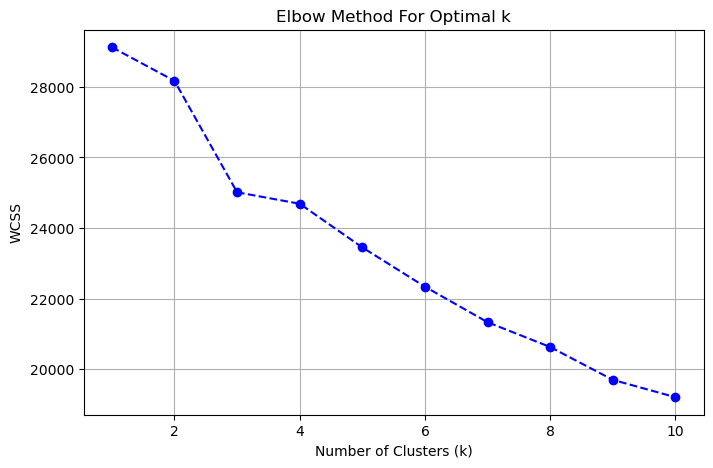

C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Wi

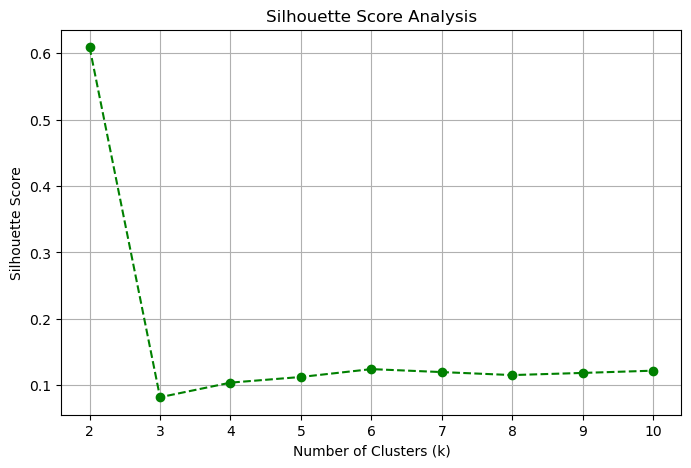

C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(


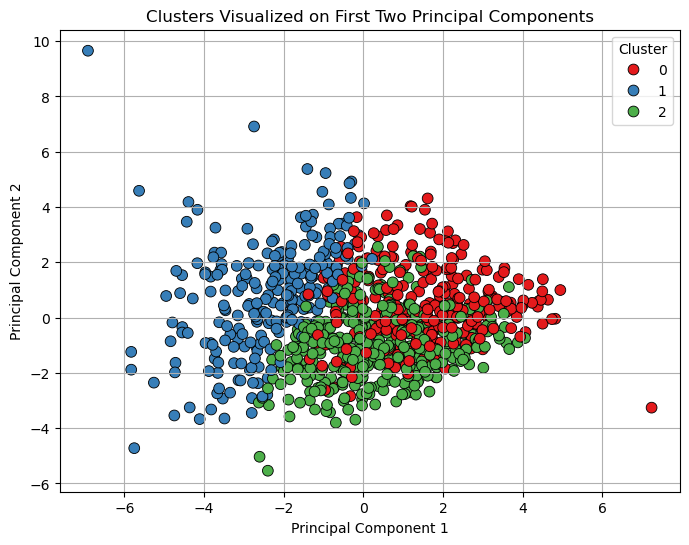

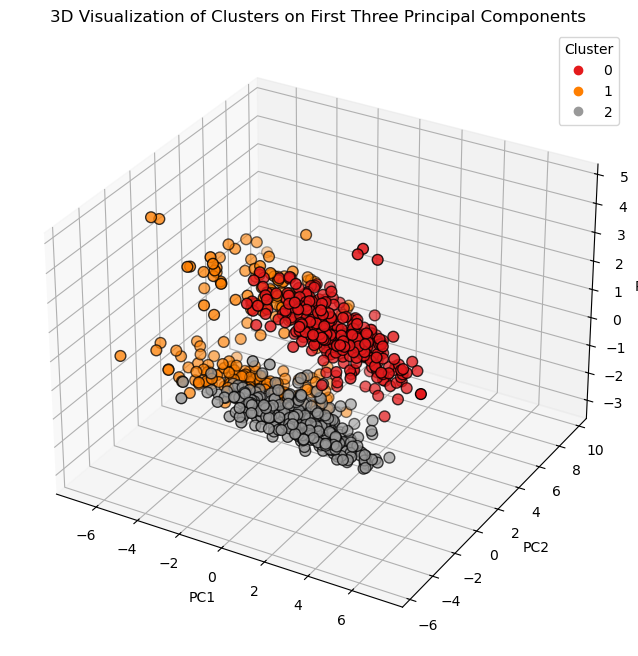

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:93: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.countplot(x='Cluster', data=pca_df, palette='Set1')


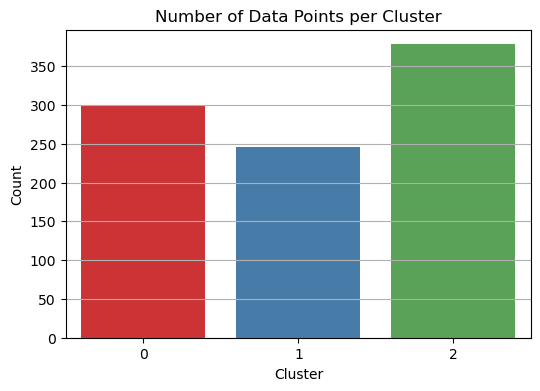

C:\Users\Locini\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  func(x=vector, **plot_kwargs)
C:\Users\Locini\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  func(x=vector, **plot_kwargs)
C:\Users\Locini\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.

  func(x=vector, **plot_kwargs)
C:\Users\Locini\anaconda3\Lib\site-packages\seaborn\axisgrid.py:1513: FutureWarning: 

`shade` is now deprecated in favor of `fill`; setting `fill=True`.
This will become an error in seaborn v0.14.0; please update your code.



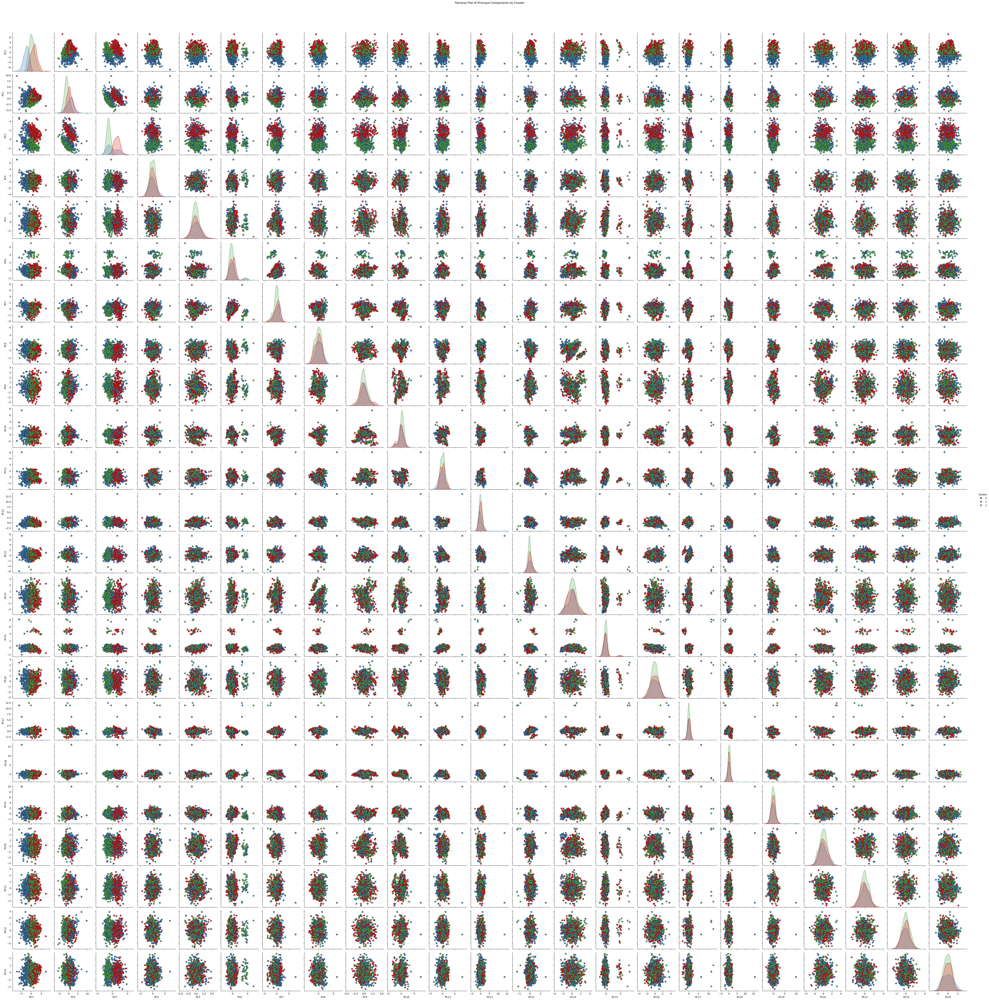

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


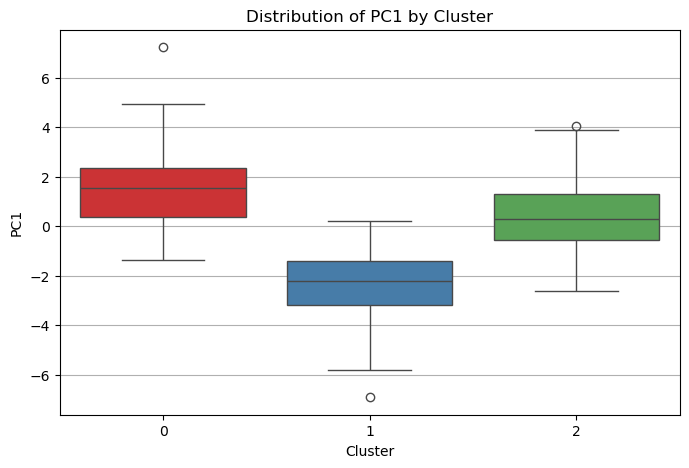

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


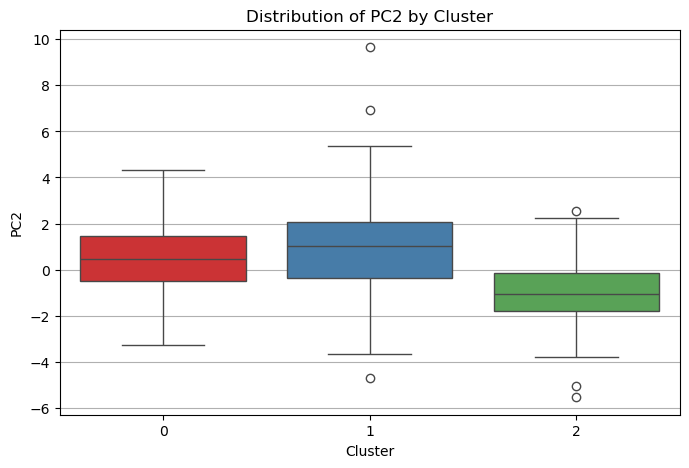

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


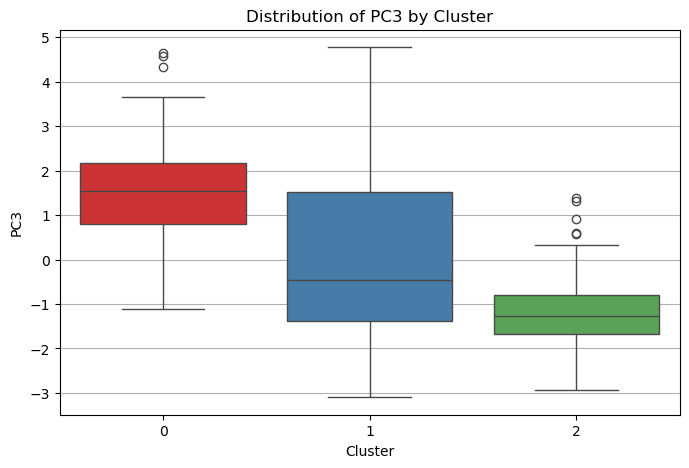

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


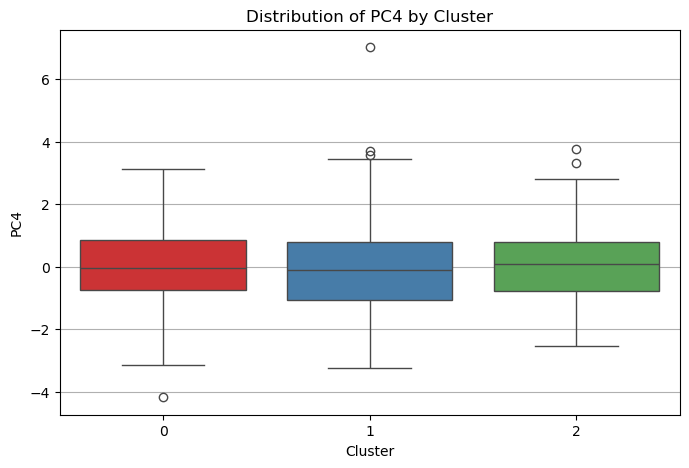

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


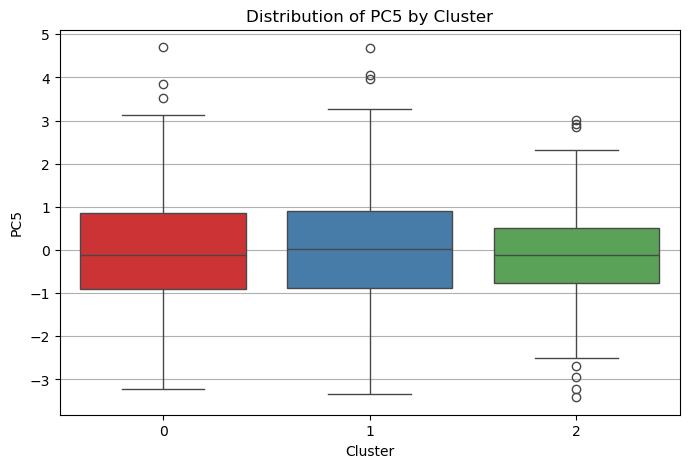

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


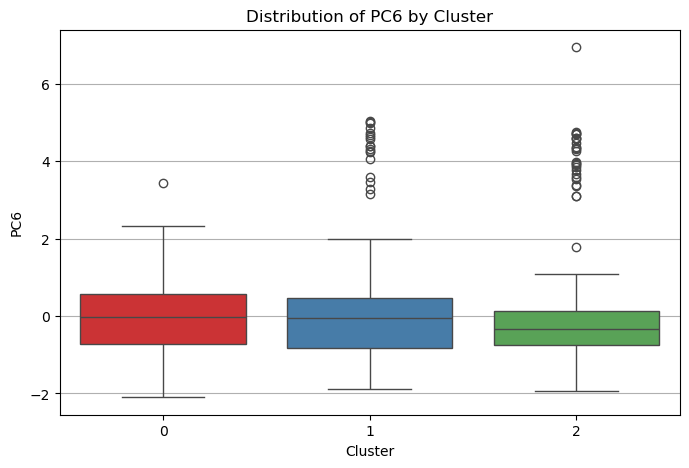

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


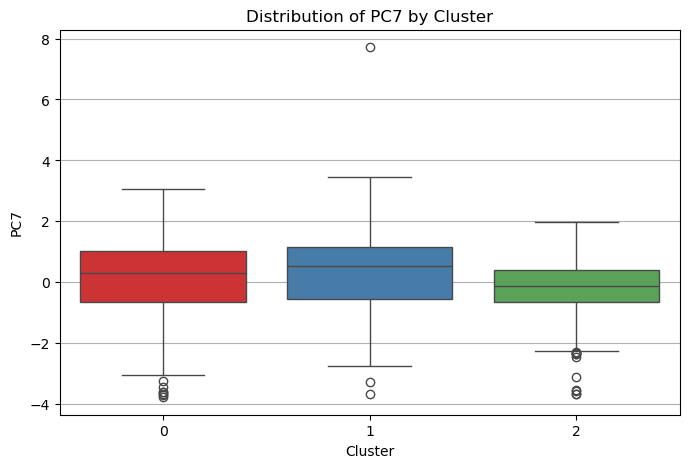

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


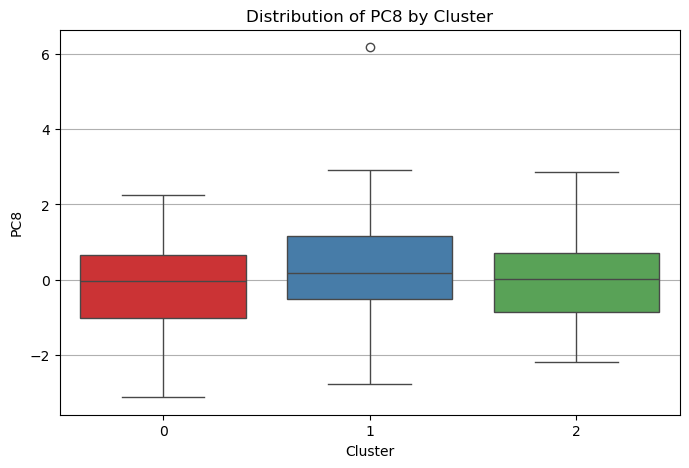

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


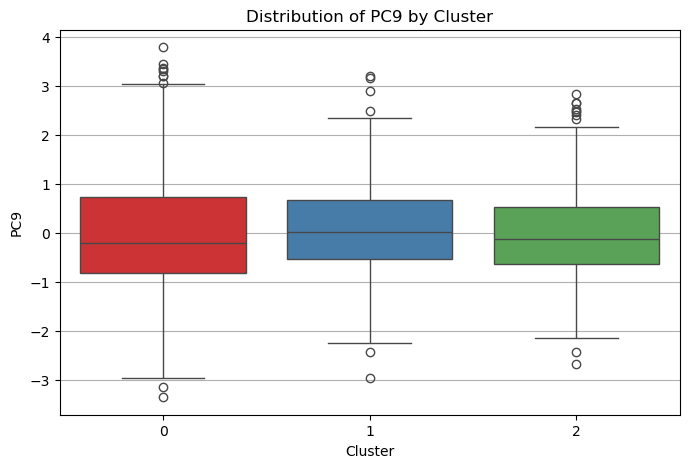

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


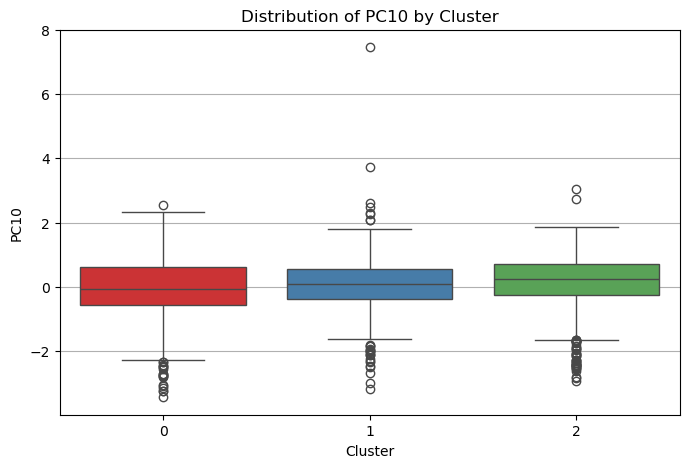

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


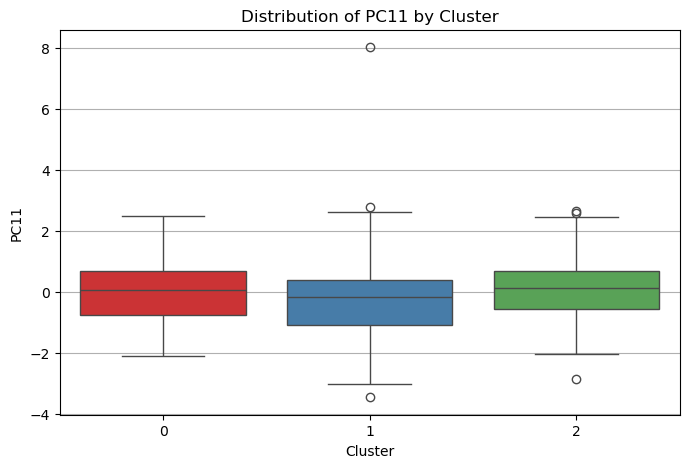

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


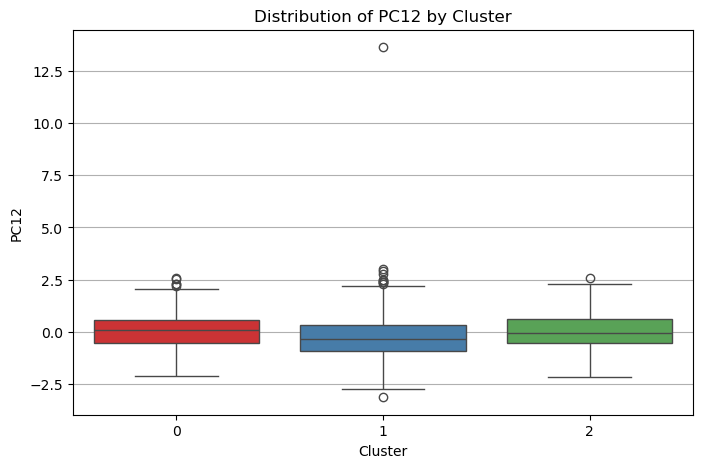

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


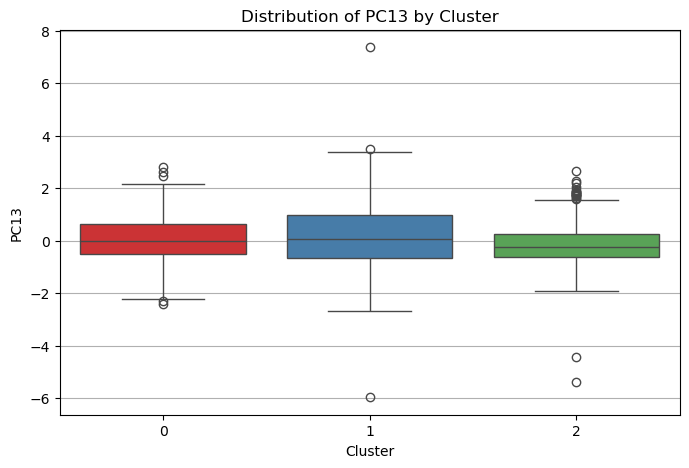

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


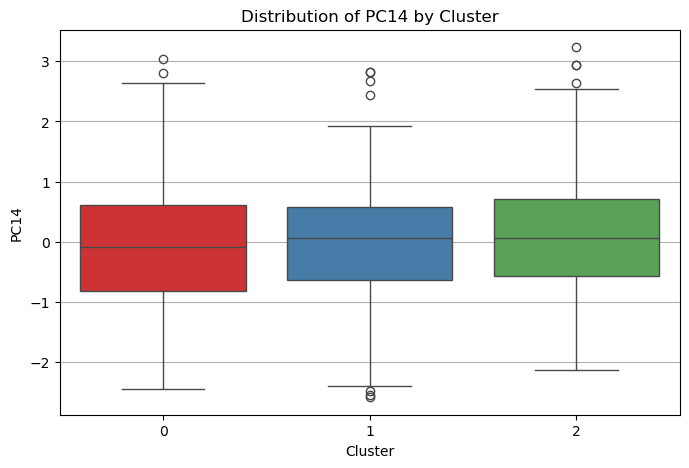

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


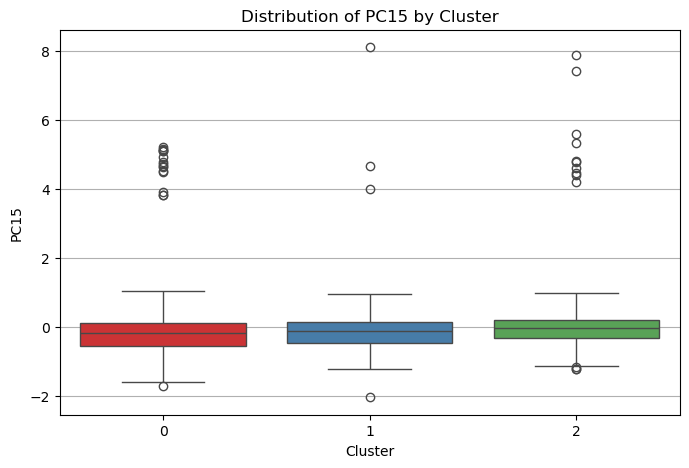

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


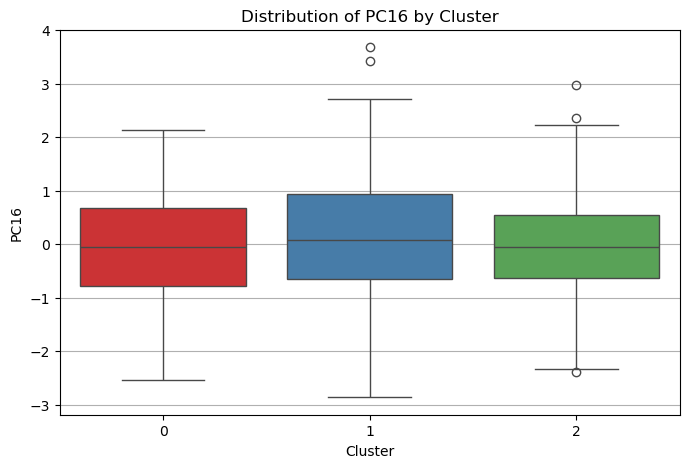

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


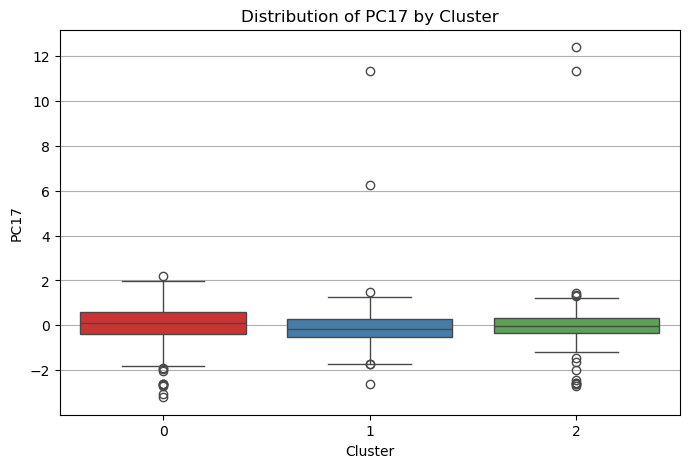

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


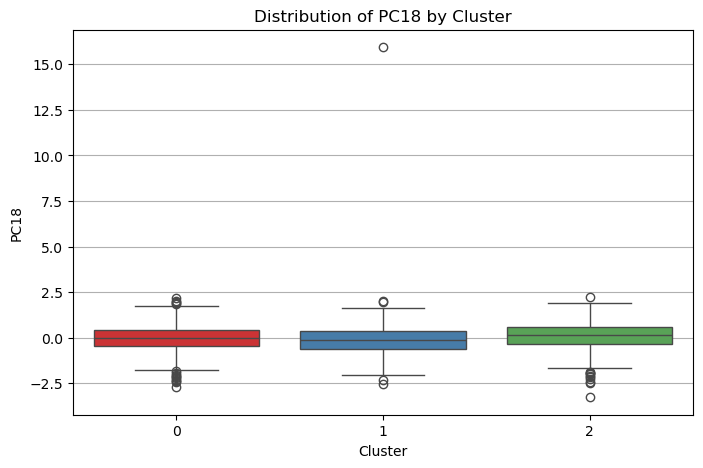

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


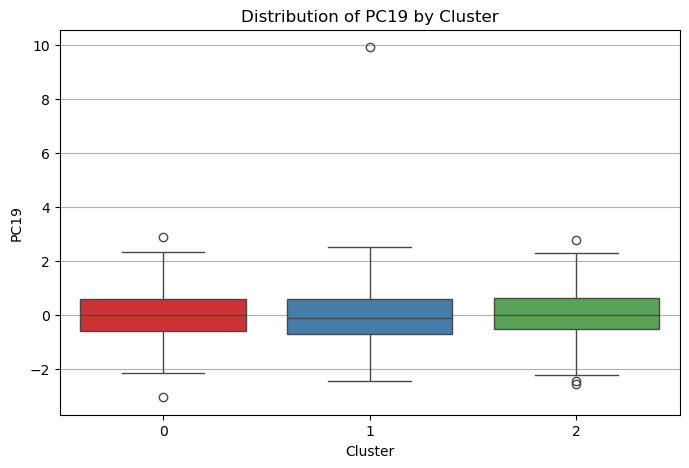

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


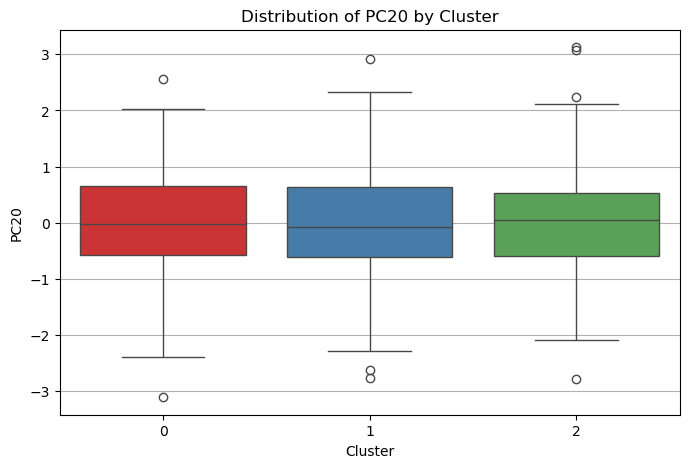

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


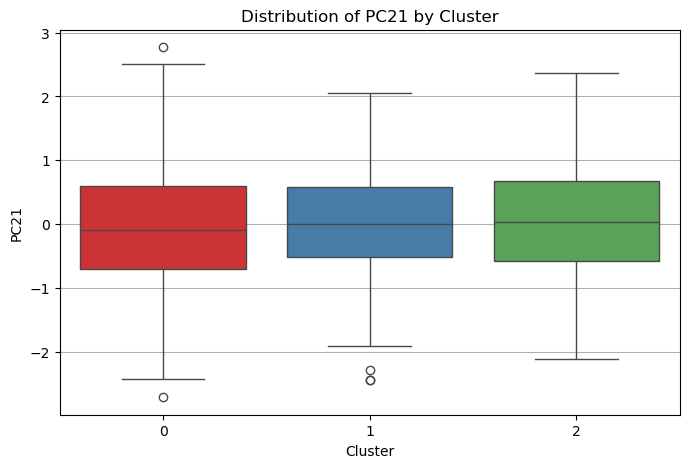

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


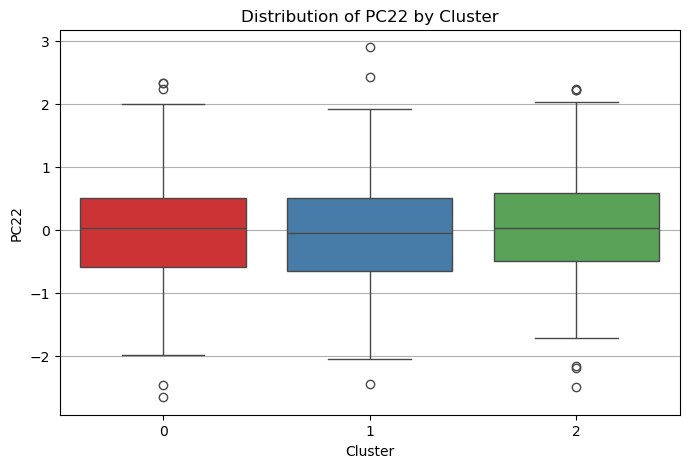

C:\Users\Locini\AppData\Local\Temp\ipykernel_9224\4225719283.py:120: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(


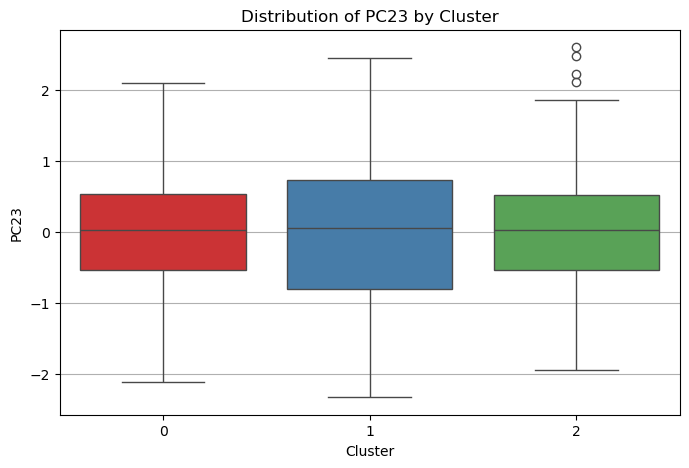

In [ ]:
# Assuming you already have pca_df with PCs

# Step 1: Import necessary libraries
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Step 2: Elbow Method to find optimal number of clusters
wcss = []
max_k = 10

for k in range(1, max_k + 1):
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(pca_df)
    wcss.append(kmeans.inertia_)

# Plot the Elbow Curve
plt.figure(figsize=(8,5))
plt.plot(range(1, max_k + 1), wcss, marker='o', linestyle='--', color='blue')
plt.title('Elbow Method For Optimal k')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('WCSS')
plt.grid(True)
plt.show()

# Step 3: Silhouette Score Analysis
silhouette_scores = []

for k in range(2, max_k + 1):
    kmeans = KMeans(n_clusters=k, random_state=42)
    labels = kmeans.fit_predict(pca_df)
    score = silhouette_score(pca_df, labels)
    silhouette_scores.append(score)

# Plot Silhouette Scores
plt.figure(figsize=(8,5))
plt.plot(range(2, max_k + 1), silhouette_scores, marker='o', linestyle='--', color='green')
plt.title('Silhouette Score Analysis')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Silhouette Score')
plt.grid(True)
plt.show()

# Step 4: Apply KMeans with the chosen optimal number of clusters
optimal_k = 3  # <-- Change after seeing elbow and silhouette
kmeans_final = KMeans(n_clusters=optimal_k, random_state=42)
cluster_labels = kmeans_final.fit_predict(pca_df)

# Add cluster labels to PCA dataframe
pca_df['Cluster'] = cluster_labels

# Step 5: Visualize Clusters - 2D
plt.figure(figsize=(8,6))
sns.scatterplot(
    x='PC1', y='PC2',
    hue='Cluster',
    palette='Set1',
    data=pca_df,
    s=60,
    edgecolor='k'
)
plt.title('Clusters Visualized on First Two Principal Components')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Cluster')
plt.grid(True)
plt.show()

# Step 6: 3D Visualization - Only if PC3 exists
if 'PC3' in pca_df.columns:
    from mpl_toolkits.mplot3d import Axes3D

    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(
        pca_df['PC1'], pca_df['PC2'], pca_df['PC3'],
        c=pca_df['Cluster'],
        cmap='Set1',
        s=60,
        edgecolor='k'
    )
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    plt.title('3D Visualization of Clusters on First Three Principal Components')
    plt.legend(*scatter.legend_elements(), title='Cluster')
    plt.show()

# Step 7: Cluster Count Bar Plot
plt.figure(figsize=(6,4))
sns.countplot(x='Cluster', data=pca_df, palette='Set1')
plt.title('Number of Data Points per Cluster')
plt.xlabel('Cluster')
plt.ylabel('Count')
plt.grid(axis='y')
plt.show()

# Select only Principal Component columns
pairplot_vars = [col for col in pca_df.columns if col.startswith('PC')]

# Create the pairplot
sns.pairplot(
    pca_df,
    vars=pairplot_vars,
    hue='Cluster',
    palette='Set1',
    diag_kind='kde',
    plot_kws={'edgecolor': 'k', 's': 40},
    diag_kws={'shade': True}
)
plt.suptitle('Pairwise Plot of Principal Components by Cluster', y=1.02)
plt.show()

# Step 9: Boxplots for Principal Components by Cluster
# One boxplot per Principal Component
for pc in pairplot_vars:
    plt.figure(figsize=(8,5))
    sns.boxplot(
        x='Cluster', 
        y=pc, 
        data=pca_df, 
        palette='Set1'
    )
    plt.title(f'Distribution of {pc} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(pc)
    plt.grid(axis='y')
    plt.show()

In [ ]:
#ALTERNATIVE MODEL FOR FACTOR ANALYSIS

C:\Users\Locini\anaconda3\Lib\site-packages\factor_analyzer\utils.py:244: UserWarning: The inverse of the variance-covariance matrix was calculated using the Moore-Penrose generalized matrix inversion, due to its determinant being at or very close to zero.
  warnings.warn(
C:\Users\Locini\anaconda3\Lib\site-packages\factor_analyzer\factor_analyzer.py:109: RuntimeWarning: invalid value encountered in log
  statistic = -np.log(corr_det) * (n - 1 - (2 * p + 5) / 6)


KMO Test Score: 0.4635
Bartlett’s Test p-value: nan


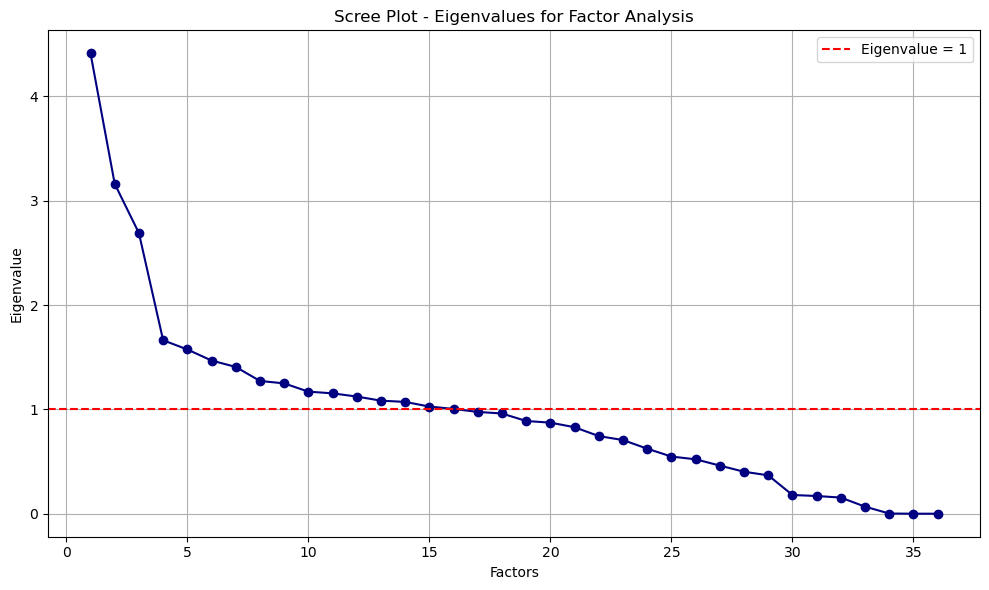


Number of Factors selected based on PCA: 23

==== Factor Loadings (Varimax Rotated) ====
                          Factor1  Factor2  Factor3  Factor4  Factor5  \
Unnamed: 0                  0.029   -0.058   -0.094   -0.139   -0.008   
latitude                    0.467    0.044   -0.032   -0.053   -0.035   
longitude                   0.739   -0.015   -0.039    0.001    0.015   
labels                     -0.027    0.966    0.079    0.113   -0.017   
age_first_funding_year      0.005   -0.062    0.309   -0.022    0.826   
age_last_funding_year       0.014    0.006    0.358    0.377    0.766   
age_first_milestone_year   -0.020    0.070    0.948    0.175    0.217   
age_last_milestone_year    -0.030    0.122    0.703    0.220    0.272   
relationships              -0.072    0.225    0.219    0.321   -0.148   
funding_rounds              0.026    0.080    0.045    0.647   -0.013   
funding_total_usd           0.031    0.024    0.046    0.127    0.047   
milestones                 -0.011 

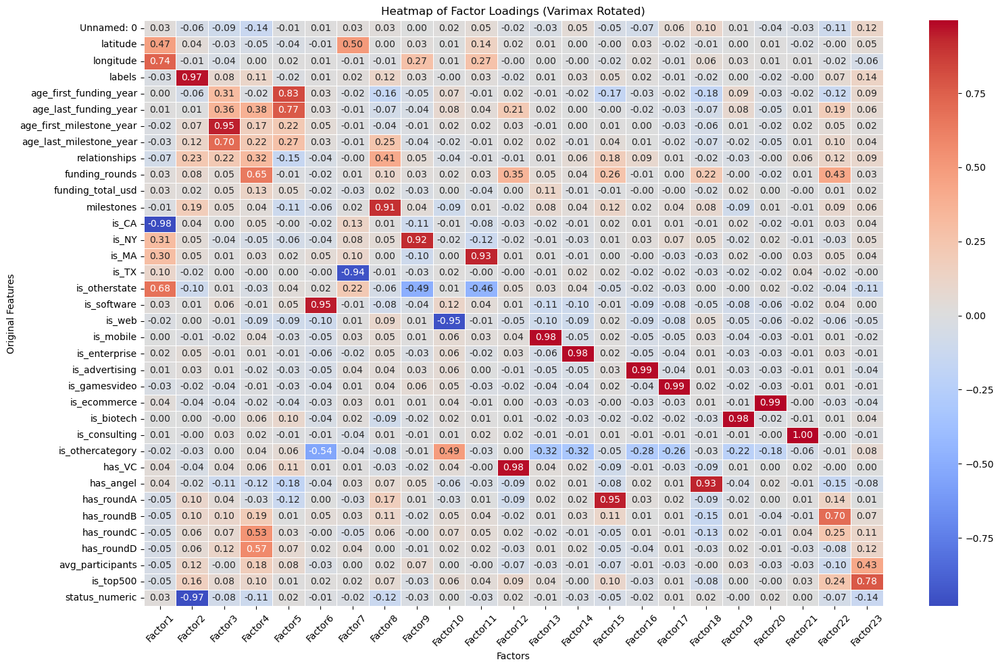


Factor loadings saved to 'startup_factor_loadings.csv'.


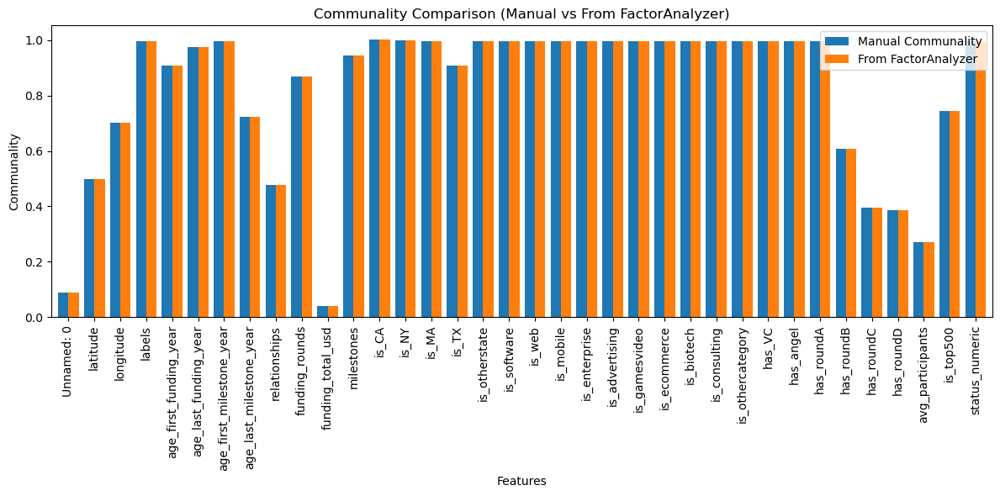

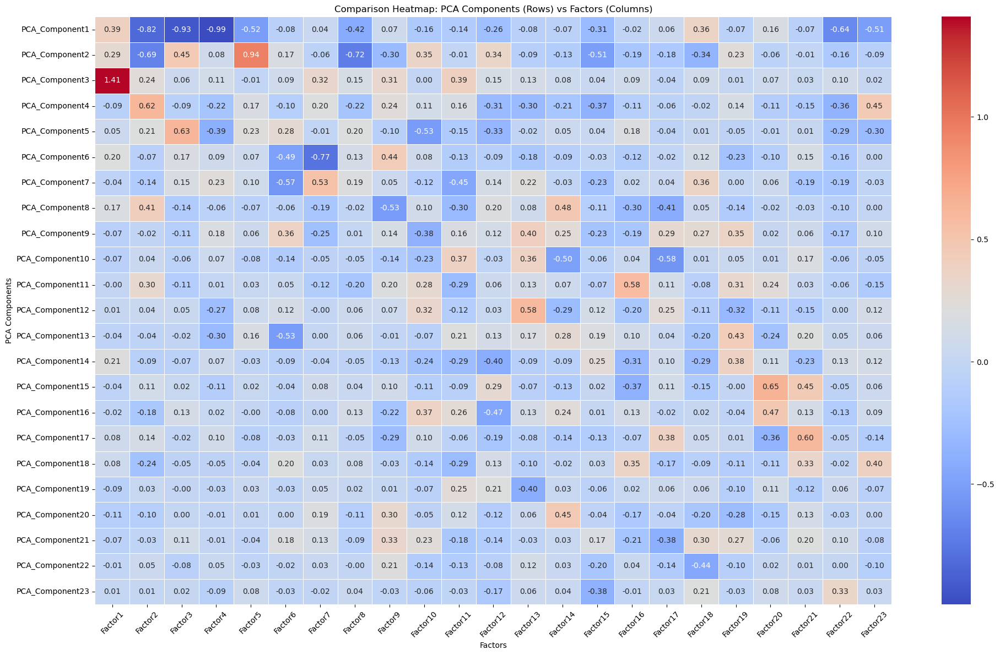

In [ ]:
# ====== FACTOR ANALYSIS for Startup Data with Detailed Steps and Visualization ======

# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from factor_analyzer import FactorAnalyzer, calculate_kmo, calculate_bartlett_sphericity
from sklearn.decomposition import PCA

# Assuming your data is already loaded into df
# df = pd.read_csv("your_file.csv")

# STEP 1: Keep Only Numeric Columns
df_numeric = df.select_dtypes(include=[np.number])

# Handle missing values
df_numeric.interpolate(inplace=True)

# STEP 2: Standardize Data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_numeric)

# STEP 3: KMO Test
kmo_all, kmo_model = calculate_kmo(scaled_data)
print(f"KMO Test Score: {kmo_model:.4f}")
if kmo_model < 0.6:
    print("Warning: KMO value is low. Factor Analysis might not be reliable.")

# STEP 4: Bartlett's Test
chi_square_value, p_value = calculate_bartlett_sphericity(scaled_data)
print(f"Bartlett’s Test p-value: {p_value:.4e}")
if p_value > 0.05:
    print("Warning: Bartlett’s test not significant. Data may not be suitable for Factor Analysis.")

# STEP 5: Eigenvalues to Decide Number of Factors
fa = FactorAnalyzer()
fa.fit(scaled_data)
eigenvalues, _ = fa.get_eigenvalues()

# Scree Plot
plt.figure(figsize=(10, 6))
plt.plot(range(1, len(eigenvalues) + 1), eigenvalues, marker='o', linestyle='-', color='navy')
plt.title('Scree Plot - Eigenvalues for Factor Analysis')
plt.xlabel('Factors')
plt.ylabel('Eigenvalue')
plt.grid(True)
plt.axhline(y=1, color='red', linestyle='--', label="Eigenvalue = 1")
plt.legend()
plt.tight_layout()
plt.show()

# STEP 6: Choose Number of Factors
n_factors = 23  # As per your PCA result
print(f"\nNumber of Factors selected based on PCA: {n_factors}")

# STEP 7: Perform Factor Analysis
fa_final = FactorAnalyzer(n_factors=n_factors, rotation='varimax')
fa_final.fit(scaled_data)

# STEP 8: Display Factor Loadings
loadings = pd.DataFrame(fa_final.loadings_, 
                        index=df_numeric.columns, 
                        columns=[f"Factor{i+1}" for i in range(n_factors)])
print("\n==== Factor Loadings (Varimax Rotated) ====")
print(loadings.round(3))

# STEP 9: Calculate Communalities
manual_communalities = (loadings**2).sum(axis=1)
communalities = pd.DataFrame({
    "Manual Communality": manual_communalities.round(4),
    "From FactorAnalyzer": fa_final.get_communalities().round(4)
}, index=df_numeric.columns)
print("\n==== Communality Comparison (Manual vs From FactorAnalyzer) ====")
print(communalities)

# STEP 10: Heatmap of Factor Loadings
plt.figure(figsize=(16, 10))
sns.heatmap(loadings, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Heatmap of Factor Loadings (Varimax Rotated)")
plt.xlabel("Factors")
plt.ylabel("Original Features")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()

# STEP 11: Save Loadings to CSV (optional)
loadings.to_csv("startup_factor_loadings.csv")
print("\nFactor loadings saved to 'startup_factor_loadings.csv'.")

# STEP 12: Plot Communality Comparison
communalities.plot(kind='bar', figsize=(12, 6), width=0.8)
plt.title("Communality Comparison (Manual vs From FactorAnalyzer)")
plt.xlabel("Features")
plt.ylabel("Communality")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

# STEP 13: PCA for Comparison
pca = PCA(n_components=n_factors)
pca_components = pd.DataFrame(pca.fit_transform(scaled_data), columns=[f"PCA_Component{i+1}" for i in range(n_factors)])

# Get PCA Loadings (components_)
pca_loadings = pd.DataFrame(pca.components_.T, 
                            index=df_numeric.columns, 
                            columns=[f"PCA_Component{i+1}" for i in range(n_factors)])

# STEP 14: Create PCA vs Factor Comparison Matrix
# Multiply PCA loadings transpose with Factor Loadings
comparison_matrix = np.dot(pca_loadings.T, loadings)

# Put into a dataframe
comparison_df = pd.DataFrame(comparison_matrix, 
                              index=[f"PCA_Component{i+1}" for i in range(n_factors)],
                              columns=[f"Factor{i+1}" for i in range(n_factors)])

# STEP 15: Plot Heatmap PCA (rows) vs Factors (columns)
plt.figure(figsize=(20, 12))
sns.heatmap(comparison_df, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title("Comparison Heatmap: PCA Components (Rows) vs Factors (Columns)")
plt.xlabel("Factors")
plt.ylabel("PCA Components")
plt.xticks(rotation=45)
plt.yticks(rotation=0)
plt.tight_layout()
plt.show()



Explained Variance Ratio (By Principal Component):
PC1: 0.1226 (12.26%)
PC2: 0.0878 (8.78%)
PC3: 0.0747 (7.47%)
PC4: 0.0462 (4.62%)
PC5: 0.0437 (4.37%)
PC6: 0.0408 (4.08%)
PC7: 0.0391 (3.91%)
PC8: 0.0353 (3.53%)
PC9: 0.0347 (3.47%)
PC10: 0.0325 (3.25%)
PC11: 0.0320 (3.20%)
PC12: 0.0312 (3.12%)
PC13: 0.0301 (3.01%)
PC14: 0.0298 (2.98%)
PC15: 0.0285 (2.85%)
PC16: 0.0279 (2.79%)
PC17: 0.0271 (2.71%)
PC18: 0.0267 (2.67%)
PC19: 0.0247 (2.47%)
PC20: 0.0242 (2.42%)
PC21: 0.0230 (2.30%)
PC22: 0.0207 (2.07%)
PC23: 0.0196 (1.96%)
PC24: 0.0173 (1.73%)
PC25: 0.0152 (1.52%)
PC26: 0.0145 (1.45%)
PC27: 0.0128 (1.28%)
PC28: 0.0112 (1.12%)
PC29: 0.0102 (1.02%)
PC30: 0.0050 (0.50%)
PC31: 0.0047 (0.47%)
PC32: 0.0043 (0.43%)
PC33: 0.0019 (0.19%)
PC34: 0.0000 (0.00%)
PC35: 0.0000 (0.00%)
PC36: 0.0000 (0.00%)


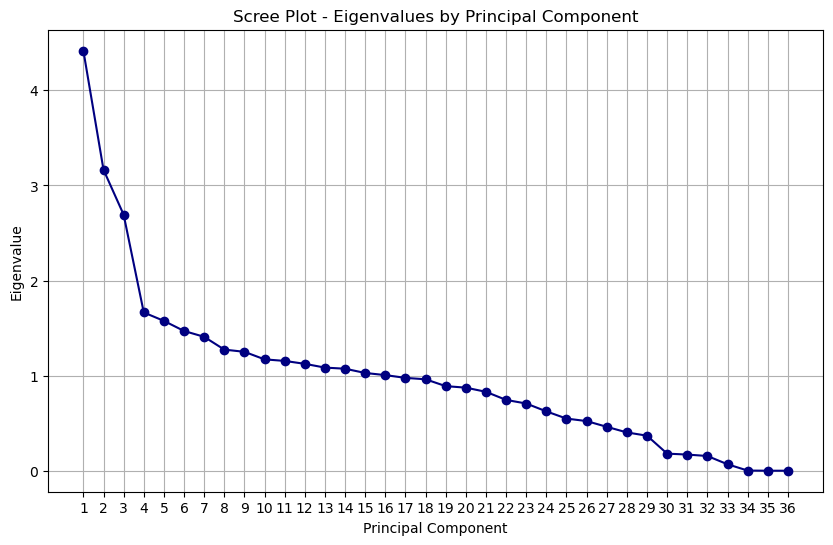

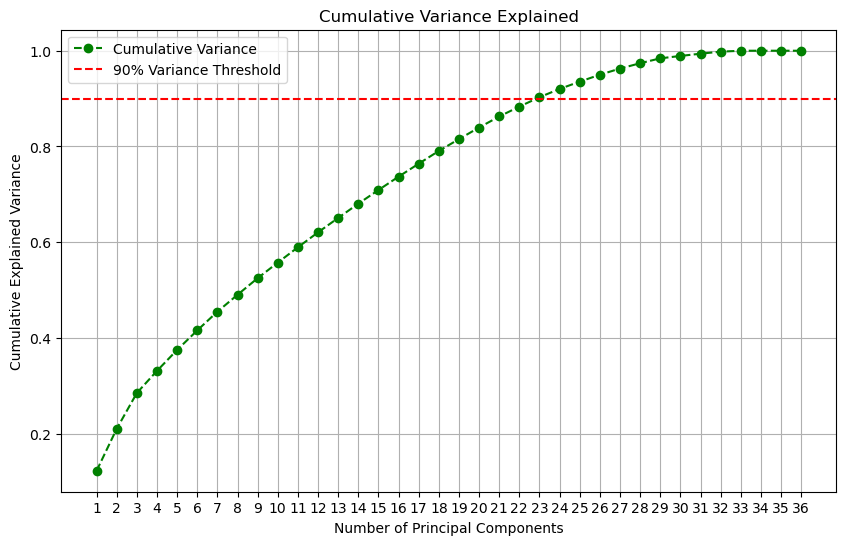


Optimal number of components to retain at least 90% variance: 23


C:\Users\Locini\anaconda3\Lib\site-packages\sklearn\cluster\_kmeans.py:1446: UserWarning: KMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can avoid it by setting the environment variable OMP_NUM_THREADS=4.
  warnings.warn(



PCA Reduced Data with Cluster Labels (First 5 rows):
        PC1       PC2       PC3       PC4       PC5       PC6       PC7  \
0  0.869729 -0.327918  0.413892  1.025104  0.888243  0.730375  1.262323   
1 -4.441453  1.675163 -0.691681 -0.275417 -0.964561 -0.316548  1.118249   
2  0.835093 -1.995623 -1.905759  1.365334  1.035107 -0.177131 -0.637073   
3 -2.845646  0.971219 -1.018840  0.777100 -0.416262 -1.221233 -0.719621   
4  3.014244 -0.290710 -1.754055 -0.563802 -1.828941 -0.687199  0.758565   

        PC8       PC9      PC10  ...      PC15      PC16      PC17      PC18  \
0  0.342598 -0.620100  0.083977  ... -0.488233  0.269527  0.865070 -2.047423   
1  1.417015  1.380404 -1.411959  ... -0.350691  0.213747 -0.447392 -0.498182   
2  0.338529  0.829955  0.506338  ...  0.373671 -0.549292 -0.388757  0.744398   
3 -0.343096  1.145197 -0.324273  ... -0.734613  0.331210  0.686860 -0.219332   
4 -1.373796  1.792747 -2.336895  ...  0.551148 -0.543477  1.539153 -0.342980   

       PC19   

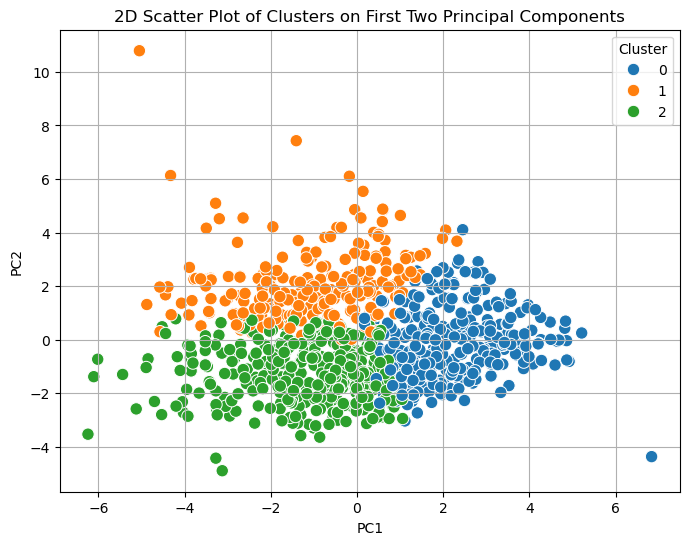

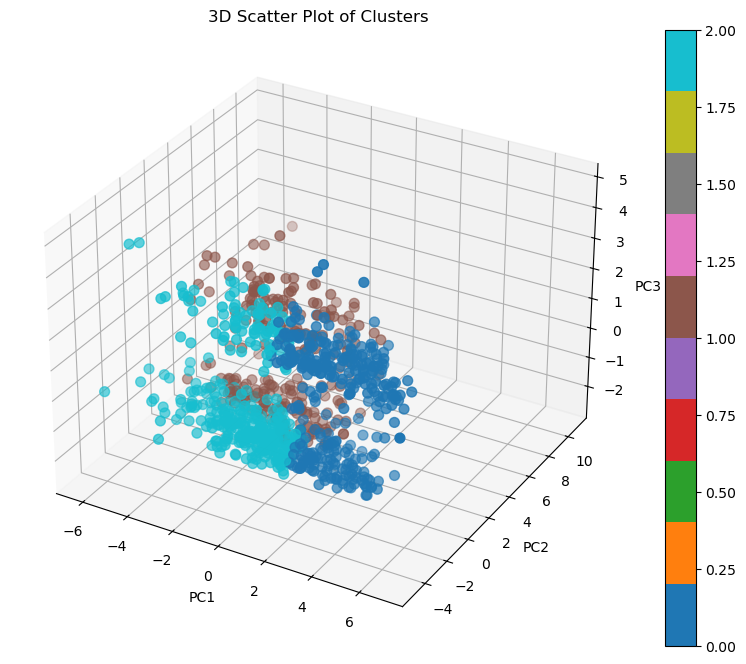


Mann-Whitney U Test Results:
      PC  Cluster1  Cluster2  U-Statistic        p-Value
0    PC1         0         1      74277.0   3.707977e-83
1    PC1         0         2     114473.0  2.427907e-109
2    PC1         1         2      45224.0   7.007753e-01
3    PC2         0         1       7941.0   1.239657e-57
4    PC2         0         2      84334.0   1.650048e-25
..   ...       ...       ...          ...            ...
64  PC22         0         2      57250.0   8.855069e-01
65  PC22         1         2      44133.0   8.975801e-01
66  PC23         0         1      32652.0   4.452893e-03
67  PC23         0         2      52210.0   3.456833e-02
68  PC23         1         2      46777.0   2.647769e-01

[69 rows x 5 columns]

Significant differences (p < 0.05):
      PC  Cluster1  Cluster2  U-Statistic        p-Value
0    PC1         0         1      74277.0   3.707977e-83
1    PC1         0         2     114473.0  2.427907e-109
3    PC2         0         1       7941.0   1.239657e-5

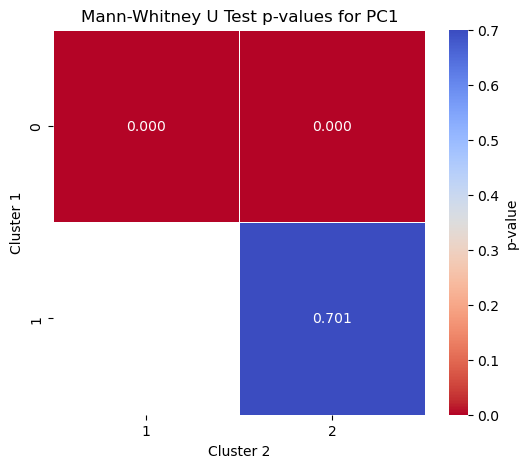

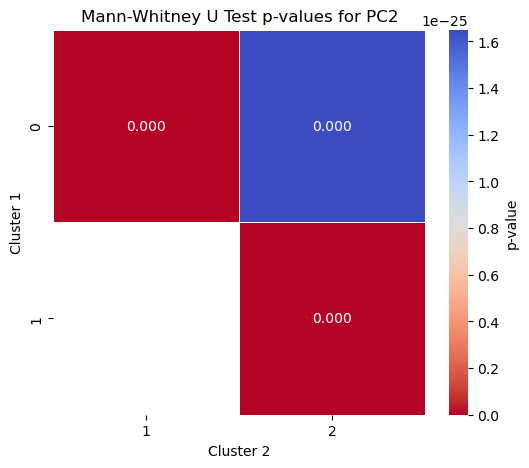

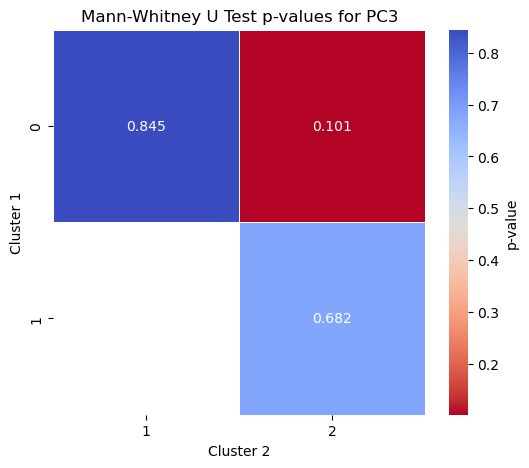

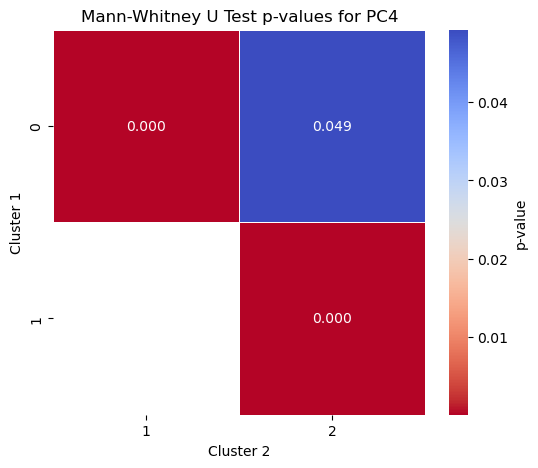

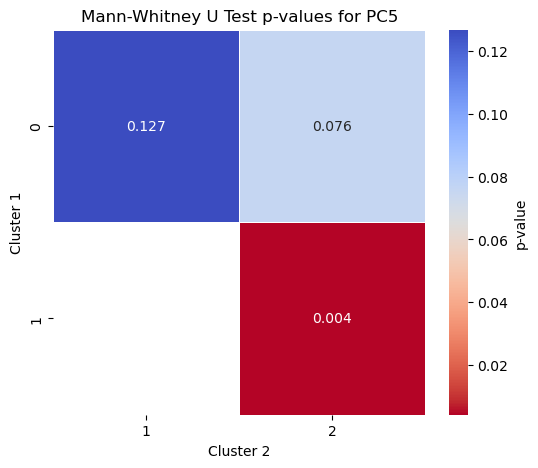

...

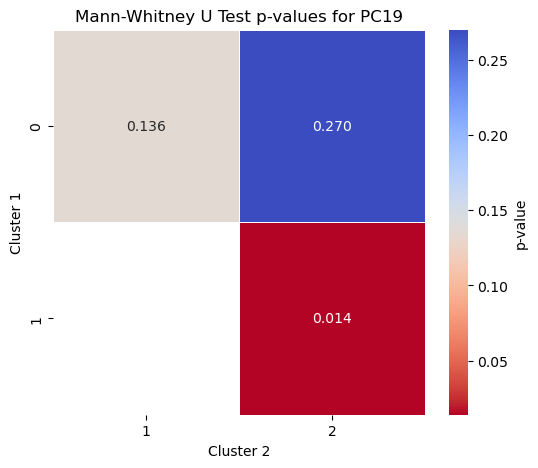

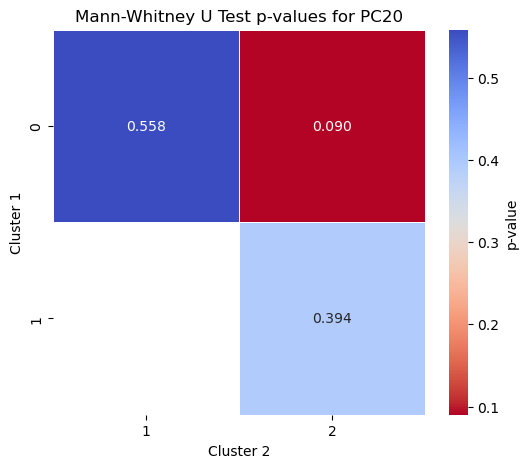

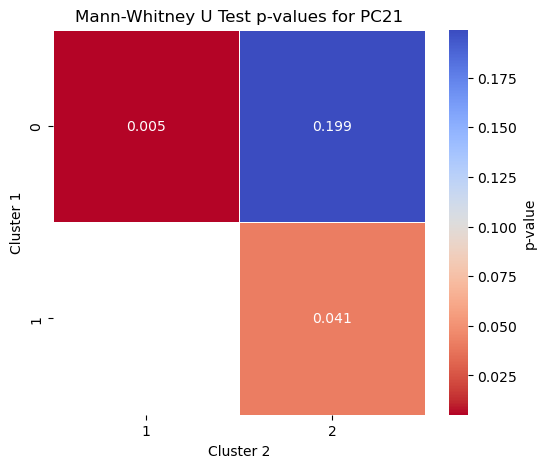

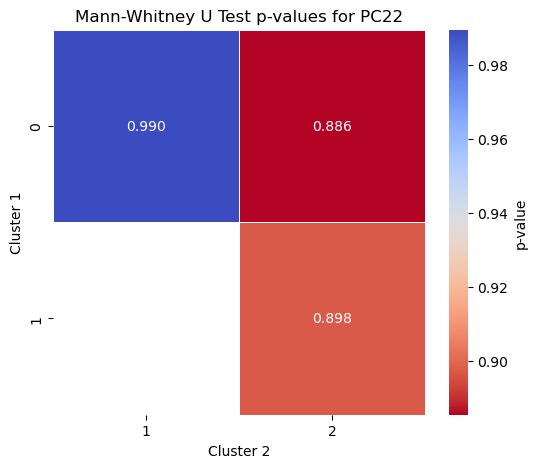

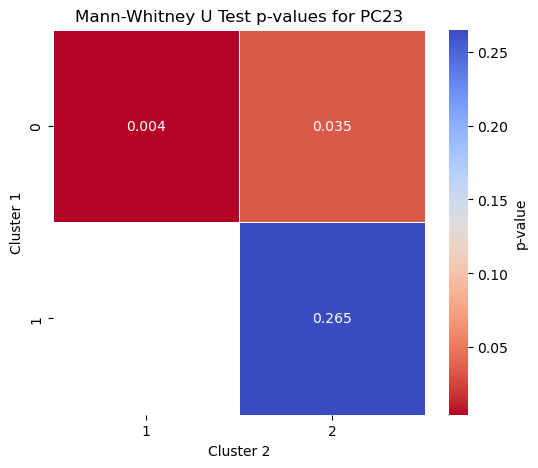

In [ ]:
# ====== Full PCA + KMeans + Mann-Whitney U Test ======

# Import necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from scipy.stats import mannwhitneyu
from mpl_toolkits.mplot3d import Axes3D

# STEP 1: Load and Prepare Data
df_numeric = df.select_dtypes(include=[np.number])

# Handle missing values
df_numeric.interpolate(inplace=True)

# STEP 2: Standardize Data
scaler = StandardScaler()
scaled_data = scaler.fit_transform(df_numeric)

# STEP 3: Apply PCA
pca = PCA()
pca_data = pca.fit_transform(scaled_data)

# STEP 4: Analyze Variance
eigenvalues = pca.explained_variance_
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Display explained variance ratios
print("\nExplained Variance Ratio (By Principal Component):")
for i, var in enumerate(explained_variance_ratio, 1):
    print(f"PC{i}: {var:.4f} ({var*100:.2f}%)")

# Scree Plot
plt.figure(figsize=(10, 6))
x_vals = range(1, len(eigenvalues) + 1)
plt.plot(x_vals, eigenvalues, marker='o', linestyle='-', color='navy')
plt.title('Scree Plot - Eigenvalues by Principal Component')
plt.xlabel('Principal Component')
plt.ylabel('Eigenvalue')
plt.xticks(x_vals)
plt.grid(True)
plt.show()

# Cumulative Variance Plot
plt.figure(figsize=(10, 6))
plt.plot(x_vals, cumulative_variance, marker='o', linestyle='--', color='green', label='Cumulative Variance')
plt.axhline(y=0.90, color='r', linestyle='--', label='90% Variance Threshold')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('Cumulative Variance Explained')
plt.xticks(x_vals)
plt.legend()
plt.grid(True)
plt.show()

# STEP 5: Determine Optimal Number of Components
optimal_components = np.argmax(cumulative_variance >= 0.90) + 1
print(f"\nOptimal number of components to retain at least 90% variance: {optimal_components}")

# STEP 6: PCA with Optimal Components
pca_final = PCA(n_components=optimal_components)
reduced_data = pca_final.fit_transform(scaled_data)

# Create PCA DataFrame
pca_columns = [f"PC{i+1}" for i in range(optimal_components)]
pca_df = pd.DataFrame(reduced_data, columns=pca_columns)

# STEP 7: Apply KMeans Clustering
kmeans = KMeans(n_clusters=3, random_state=42)   # You can change n_clusters
cluster_labels = kmeans.fit_predict(reduced_data)

# Add Cluster labels to PCA DataFrame
pca_df['Cluster'] = cluster_labels

print("\nPCA Reduced Data with Cluster Labels (First 5 rows):")
print(pca_df.head())

# STEP 8: Scatter Plot with Clusters (2D)
if optimal_components >= 2:
    plt.figure(figsize=(8,6))
    sns.scatterplot(data=pca_df, x='PC1', y='PC2', hue='Cluster', palette='tab10', s=80)
    plt.title('2D Scatter Plot of Clusters on First Two Principal Components')
    plt.grid(True)
    plt.show()

# STEP 9: Scatter Plot with Clusters (3D)
if optimal_components >= 3:
    fig = plt.figure(figsize=(10,8))
    ax = fig.add_subplot(111, projection='3d')
    scatter = ax.scatter(pca_df['PC1'], pca_df['PC2'], pca_df['PC3'], c=pca_df['Cluster'], cmap='tab10', s=50)
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    ax.set_title('3D Scatter Plot of Clusters')
    plt.colorbar(scatter)
    plt.show()

# STEP 10: Mann-Whitney U Test between Clusters

# Prepare
pcs = [col for col in pca_df.columns if col.startswith('PC')]
clusters = pca_df['Cluster'].unique()
cluster_pairs = list(itertools.combinations(clusters, 2))

# Perform Mann-Whitney U Tests
results = []

for pc in pcs:
    for (cluster1, cluster2) in cluster_pairs:
        data1 = pca_df[pca_df['Cluster'] == cluster1][pc]
        data2 = pca_df[pca_df['Cluster'] == cluster2][pc]
        
        stat, p = mannwhitneyu(data1, data2, alternative='two-sided')
        
        results.append({
            'PC': pc,
            'Cluster1': cluster1,
            'Cluster2': cluster2,
            'U-Statistic': stat,
            'p-Value': p
        })

# Create Results DataFrame
results_df = pd.DataFrame(results)
print("\nMann-Whitney U Test Results:")
print(results_df)

# Filter Significant Results
significant_results = results_df[results_df['p-Value'] < 0.05]
print("\nSignificant differences (p < 0.05):")
print(significant_results)

# STEP 11: Visualization - Heatmaps of p-values

# For each PC, create a heatmap
for pc in pcs:
    pivot_table = results_df[results_df['PC'] == pc].pivot(
        index='Cluster1', 
        columns='Cluster2', 
        values='p-Value'
    )

    plt.figure(figsize=(6,5))
    sns.heatmap(
        pivot_table, 
        annot=True, 
        fmt=".3f", 
        cmap="coolwarm_r", 
        linewidths=0.5, 
        cbar_kws={'label': 'p-value'}
    )
    plt.title(f'Mann-Whitney U Test p-values for {pc}')
    plt.xlabel('Cluster 2')
    plt.ylabel('Cluster 1')
    plt.show()
